
> setwd("/users/genomics/xoel/codebases/co_new/results/")

> plotdir <- "Plots/"

> dir.create(plotdir, showWarnings = F)

> library(ggplot2)


Warning message:
“package ‘ggplot2’ was built under R version 4.2.3”



> library(ggh4x)

> library(ggpubr)

> library(ggrepel)


Warning message:
“package ‘ggrepel’ was built under R version 4.2.2”



> library(tidyr)


Warning message:
“package ‘tidyr’ was built under R version 4.2.2”



> library(dplyr)


Warning message:
“package ‘dplyr’ was built under R version 4.2.3”

Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union





> fig <- function(width, heigth) {
+     options(repr.plot.width = width, repr.plot.height = heigth)
+ }

> CellTypeAnnot <- c("vRG E", "vRG L", "tRG", "oRG E", 
+     "oRG L", "nIPC", "Neu E", "GluN3", "GluN1", "GluN2", "GluN7", 
+     "GluN5", "GluN4", " ..." ... [TRUNCATED] 

> CellTypeOrder <- c("RGC", "vRG", "vtRG", "oRG", "RG E", 
+     "RG L", "vRG E", "vRG L", "tRG", "oRG E", "oRG L", "Neural", 
+     "GluN", "nIPC", " ..." ... [TRUNCATED] 

> CellTypeLabels <- CellTypeOrder

> CellTypeColor <- setNames(c("#bec1d4", "#7d87b9", 
+     "#023fa5", "#d6bcc0", "#bb7784", "#8e063b", "#b5bbe3", "#8595e1", 
+     "#4a6fe3", "#e6afb ..." ... [TRUNCATED] 

> ctinfo <- data.frame(hex = CellTypeColor, Name = factor(names(CellTypeColor))) %>% 
+     mutate(`Common label` = Name)

> plot.celltype <- ggplot(data = ctinfo, mapping = aes(x = 0, 
+     y = Name, fill = `Common label`)) + geom_tile() + scale_fill_manual(values = Cell .... [TRUNCATED] 

> plot.celltype

> write.csv(ctinfo, file =

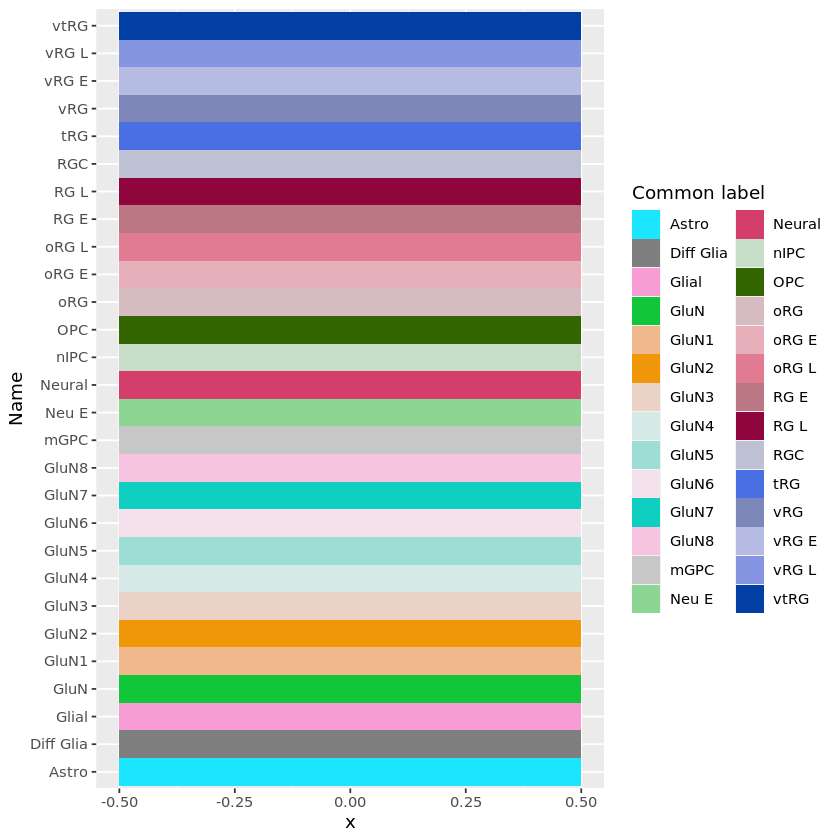

In [1]:
source('0_Rplots.R', echo=T)

In [2]:
pdir <- paste0(getwd(), '/Plots/PSS/')
dir.create(pdir, showWarnings = F, recursive = T)
setwd(pdir)

In [3]:
group_samples <- unique(psss$groupsample)

In [4]:
sel.celltypes <- c(
    # "RGC", "vRG", "vtRG", "oRG", "RG E", "RG L", 
    "vRG E", "vRG L", "tRG", "oRG E", "oRG L", 
    # "Neural", "GluN", 
    "Neu E", "nIPC", "GluN3", "GluN1", "GluN2", "GluN7", "GluN5", "GluN4", "GluN6", "GluN8",
    # "Glial", "Diff Glia", 
    "mGPC", "Astro", "OPC"
)

In [5]:
pss_per_groupsample <- lapply(
    split(psss, psss$groupsample), 
    function(x){
        max.score <- max(x$log1p)
        req.score <- max.score/5
        x$over.20pct <- x$log1p > req.score
        # x$color <- ifelse(x$over.20pct, 'red', NA)
        x
})

In [6]:
pal <- setNames(CellTypeColor[unique(psss$group)], unique(psss$group))
pal[is.na(pal)] <- 'grey'

In [7]:
pal

vRG          vtRG           oRG          RG E          RG L 
    "#7d87b9"     "#023fa5"     "#d6bcc0"     "#bb7784"     "#8e063b" 
          RGC         Glial     Diff Glia         vRG E         vRG L 
    "#bec1d4"     "#f79cd4"     "#7f7f7f"     "#b5bbe3"     "#8595e1" 
          tRG         oRG E         oRG L          mGPC         Astro 
    "#4a6fe3"     "#e6afb9"     "#e07b91"     "#c7c7c7"     "#1CE6FF" 
          OPC    Whole data       not_vRG      not_vtRG       not_oRG 
    "#336600"        "grey"        "grey"        "grey"        "grey" 
     not_RG E      not_RG L       not_RGC     not_Glial not_Diff Glia 
       "grey"        "grey"        "grey"        "grey"        "grey" 
    not_vRG E     not_vRG L       not_tRG     not_oRG E     not_oRG L 
       "grey"        "grey"        "grey"        "grey"        "grey" 
     not_mGPC     not_Astro       not_OPC        Neural          GluN 
       "grey"        "grey"        "grey"     "#d33f6a"     "#11c638" 
         nIPC         Neu E         GluN1         GluN2         GluN3 
    "#c6dec7"     "#8dd593"     "#f0b98d"     "#ef9708"     "#ead3c6" 
        GluN7    not_Neural      not_GluN      not_nIPC     not_Neu E 
    "#0fcfc0"        "grey"        "grey"        "grey"        "grey" 
    not_GluN1     not_GluN2     not_GluN3     not_GluN7         GluN4 
       "grey"        "grey"        "grey"        "grey"     "#d5eae7" 
        GluN5     not_GluN4     not_GluN5         GluN6     not_GluN6 
    "#9cded6"        "grey"        "grey"     "#f3e1eb"        "grey" 
        GluN8     not_GluN8 
    "#f6c4e1"        "grey"

### TESTS

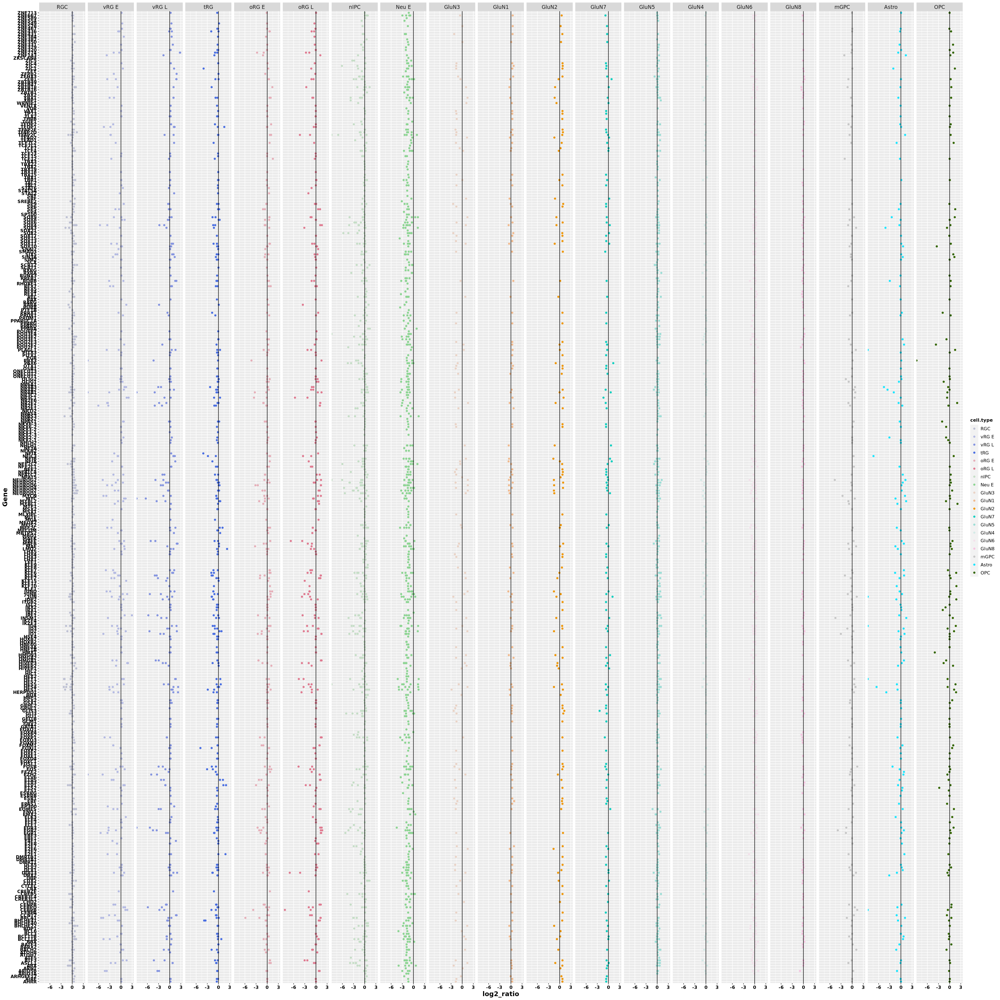

In [8]:
fig(30,30)
ggplot(Perturbations, aes(x=log2_ratio, y=Gene, color=cell.type)) + 
    # facet_wrap(~cell.type) +
    facet_grid(cols=vars(cell.type)) +
    scale_color_manual(values=CellTypeColor) +
    geom_point() +
    geom_vline(xintercept = 0) + 
    # theme_pubr(base_family = 'ArialMT') +
    labs_pubr()

In [29]:
tes <- subset(Perturbations, (Sample=='Gliogenesis')) %>% 
    arrange(n_change)%>% ungroup() %>% group_by(cell.type) %>% 
    mutate(midscale_nchange=scales::rescale_mid(n_change, to=c(-1,1), mid=0), 
           Gene.fct =factor(Gene, rev(unique(Gene)))) %>%
    ungroup() %>% arrange(cell.type, Gene.fct)


In [30]:
tesrange <- range(tes$midscale_nchange)
teslims <- rep(max(abs(tesrange)),2) * c(-1,1)
# teslims <- tesrange

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
Warning message:
“Removed 16 rows containing missing values (`geom_bar()`).”


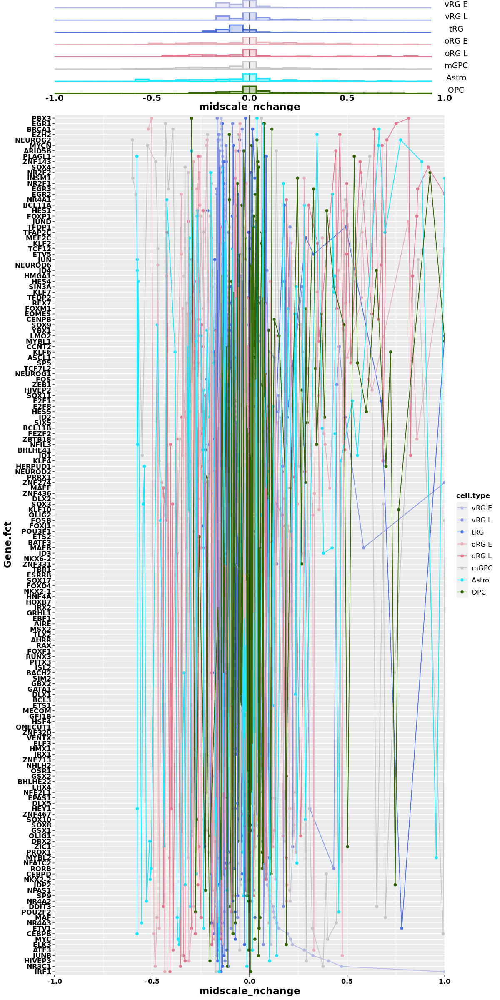

In [52]:
fig(10,20)
# ggplot(Perturbations, aes(x=paste(cell.type, Pert), y=Gene, fill=log1p(ratio))) + 
ggplot(tes, aes(x=midscale_nchange, y=Gene.fct, color=cell.type)) + 
    scale_color_manual(values=CellTypeColor) +
    geom_point() +
    geom_line(aes(group=cell.type)) +
    # scale_color_viridis_c(option='turbo') + 
    geom_vline(xintercept = 0) + 
    # theme_pubr(base_family = 'ArialMT') +
    scale_x_continuous(limits=teslims, expand=expansion(mult=c(0,0)))+
    labs_pubr() -> p1
ggplot(tes, aes(x=midscale_nchange, fill=cell.type, group=cell.type, color=cell.type)) + 
    scale_fill_manual(values=CellTypeColor, guide=guide_none()) +
    facet_grid(rows=vars(cell.type), scales='free_y') +
    scale_color_manual(values=CellTypeColor, guide=guide_none()) +
    # geom_point() +
    geom_vline(xintercept = 0) + 
    # geom_density(linewidth=1)+
    geom_histogram(linewidth=1, alpha=0.3)+
    # scale_color_viridis_c(option='turbo') + 
    # theme_pubr(base_family = 'ArialMT') +
    scale_x_continuous(limits=teslims, expand=expansion(mult=c(0,0)))+
    theme_void() + theme(axis.ticks = element_blank(), axis.text.y.left = element_blank(), axis.title.y.left = element_blank()) +
    labs_pubr() -> p2

cowplot::plot_grid(p2,p1, ncol = 1, align = 'v', axis='lr', rel_heights = c(1,8))

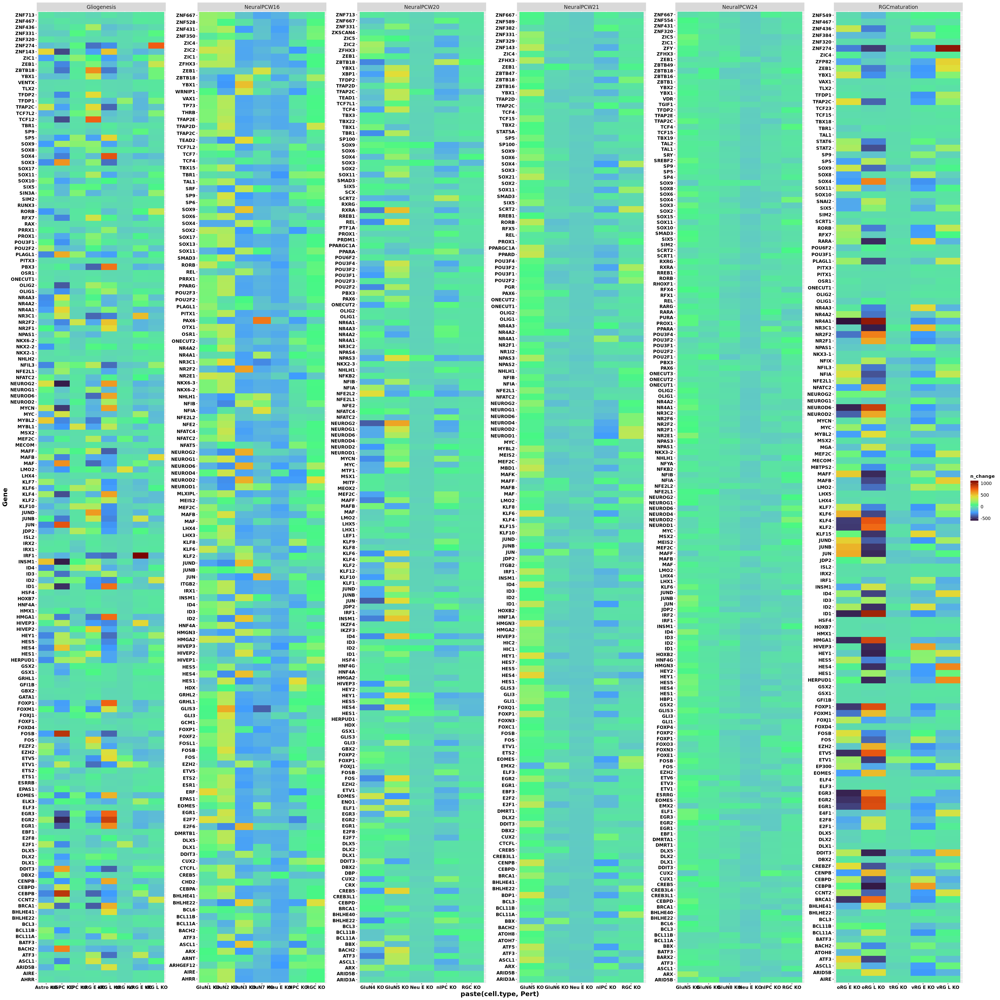

In [13]:
fig(30,30)
# ggplot(Perturbations, aes(x=paste(cell.type, Pert), y=Gene, fill=log1p(ratio))) + 
ggplot(Perturbations, aes(x=paste(cell.type, Pert), y=Gene, fill=n_change)) + 
    # facet_wrap(~cell.type) +
    facet_grid2(cols=vars(Sample), scales='free', independent = 'y') +
    # scale_fill_manual(values=CellTypeColor) +
    geom_tile() +
    scale_fill_viridis_c(option='turbo') + 
    # geom_vline(xintercept = 0) + 
    # theme_pubr(base_family = 'ArialMT') +
    labs_pubr()

### Plot functions

In [8]:
library(ggplot2)
library(ggrepel)
library(ggpubr)

plot_pss_comp <- function(
    pss.df,
    g1, g2    
){
    p <- ggplot(
        pss.df, 
        aes(x=log1p.g1, y=log1p.g2, 
            label=ifelse(do.label, gene, NA),
            # color=do.label,
            color=color,
            # size= log1p.g1,
            # color=log1p.g2
           )) + 
        ggtitle(paste0(g1, ' vs ', g2)) + 
        scale_color_identity() + 
        geom_point() +
        geom_text_repel(size=4, max.overlaps=Inf) +
        theme_pubr() + 
        labs_pubr() +
        labs(x=g1, y=g2) + 
        theme(text=element_text(family='ArialMT'))
    return(p)
}

In [11]:
comparisons <- list(
    c('vRG (Gliogenesis)', 'tRG (Gliogenesis)'),
    c('vRG (Gliogenesis)', 'oRG (Gliogenesis)'),
    c('vtRG (Gliogenesis)', 'oRG (Gliogenesis)'),
    c('RGC (NeuralPCW20)', 'nIPC (NeuralPCW20)'),
    c('RGC (NeuralPCW20)', 'Neural (NeuralPCW20)'),
    c('RGC (NeuralPCW20)', 'GluN (NeuralPCW20)'),
    c('RGC (Gliogenesis)', 'mGPC (Gliogenesis)'),
    c('RGC (Gliogenesis)', 'Glial (Gliogenesis)'),
    c('Astro (Gliogenesis)', 'OPC (Gliogenesis)')
)

In [12]:
pdf(paste0('Pairwise comparison.selected.pdf'))

for (comp in comparisons){
    g1 <- comp[[1]]
    g2 <- comp[[2]]
    g1.sample <- unique(pss_per_groupsample[[g1]]$sample)
    g1.group <- unique(pss_per_groupsample[[g1]]$group)
    g2.sample <- unique(pss_per_groupsample[[g2]]$sample)
    g2.group <- unique(pss_per_groupsample[[g2]]$group)


    print(paste(g1, 'vs', g2))
    pss.df <- merge(
        pss_per_groupsample[[g1]], 
        pss_per_groupsample[[g2]],
        by = 'gene',
        all = T, 
        suffixes = c('.g1', '.g2')
    )
    pss.df$do.label <- apply(pss.df[, c('over.20pct.g1','over.20pct.g2')], 1, sum, na.rm = T) == 1

    pss.df$color <- apply(pss.df[, c('over.20pct.g1','over.20pct.g2')], 1, function(x){
        x <- x 
        x[is.na(x)] <- FALSE
        if (x['over.20pct.g1'] & x['over.20pct.g2']) {'grey'}
        else if (x['over.20pct.g1']) {'red'}
        else if (x['over.20pct.g2']) {'blue'}
        else {'grey'}
    })
    
    pss.df[is.na(pss.df)] <- 0
    suppressWarnings(expr = {
        p <- plot_pss_comp(pss.df, g1,g2)
        plot(p)
    })
    
    
    
    
    sel.pss <- pss.df[pss.df$color != 'grey',]

    sel.pss$diff <- sel.pss$log1p.scaled.g2 - sel.pss$log1p.scaled.g1
    sel.lvs <- (sel.pss%>%arrange(desc(diff)))$gene

    # fig(5, 10)
    p2 <- ggplot(sel.pss, aes(x=diff, y=factor(gene, sel.lvs))) + geom_point() + ggtitle(paste(g1,'vs', g2)) + theme_pubr() + scale_x_continuous(limits=c(-1,1)) + theme(panel.grid.major.x=element_line(),panel.grid.major.y=element_line())
    plot(p2)
    
    sel.top <- unique(c(head(sel.lvs, n = 10), tail(sel.lvs, n=10)))

    p3 <- ggplot(subset(sel.pss,
                        gene%in%sel.top),
                 aes(x=diff, y=factor(gene, sel.lvs))) + geom_point() + ggtitle(paste(g1,'vs', g2)) + theme_pubr() + scale_x_continuous(limits=c(-1,1)) + theme(panel.grid.major.x=element_line(),panel.grid.major.y=element_line())
    
    plot(p3)
}
dev.off()


[1] "vRG (Gliogenesis) vs tRG (Gliogenesis)"
[1] "vRG (Gliogenesis) vs oRG (Gliogenesis)"
[1] "vtRG (Gliogenesis) vs oRG (Gliogenesis)"
[1] "RGC (NeuralPCW20) vs nIPC (NeuralPCW20)"
[1] "RGC (NeuralPCW20) vs Neural (NeuralPCW20)"
[1] "RGC (NeuralPCW20) vs GluN (NeuralPCW20)"
[1] "RGC (Gliogenesis) vs mGPC (Gliogenesis)"
[1] "RGC (Gliogenesis) vs Glial (Gliogenesis)"
[1] "Astro (Gliogenesis) vs OPC (Gliogenesis)"


png 
  2

# Check correlation of same cell types in different subsets

In [13]:
ScoreInclude

[1] "degree_all"             "degree_centrality_all"  "degree_in"             
 [4] "degree_centrality_in"   "degree_out"             "degree_centrality_out" 
 [7] "betweenness_centrality" "eigenvector_centrality" "connectivity"          
[10] "participation"

In [12]:
head(psss)

group,score,gene,sample,groupsample,log1p,cell.type,groupFct,sampleFct,log1p.scaled,Control
<chr>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<chr>,<fct>,<fct>,<dbl>,<chr>
vRG,1.339978e-04,AIRE,RGCmaturation,vRG (RGCmaturation),1.339888e-04,vRG,vRG,RGCmaturation,0.0004696602,control
vtRG,1.340006e-04,AIRE,RGCmaturation,vtRG (RGCmaturation),1.339916e-04,vtRG,vtRG,RGCmaturation,0.0003774217,control
oRG,3.686897e-03,AIRE,RGCmaturation,oRG (RGCmaturation),3.680117e-03,oRG,oRG,RGCmaturation,0.0063076165,control
RG E,8.461723e-05,AIRE,RGCmaturation,RG E (RGCmaturation),8.461365e-05,RG E,RG E,RGCmaturation,0.0003423314,control
RG L,1.339978e-04,AIRE,RGCmaturation,RG L (RGCmaturation),1.339888e-04,RG L,RG L,RGCmaturation,0.0004696602,control
vRG E,8.461723e-05,AIRE,RGCmaturation,vRG E (RGCmaturation),8.461365e-05,vRG E,vRG E,RGCmaturation,0.0003423314,control


In [11]:

pss.df <- subset(psss, group %in% CellTypeAnnot)[, c('gene', 'group', 'sample', 'log1p.scaled')] %>% 
        reshape2::dcast(formula = 'gene + group ~ sample', value.var='log1p.scaled')

pss.df <- pss.df[apply(pss.df, 1, function(x){sum(is.na(x))<=1}),]

pss.df$RGCmat.Glio <- apply(pss.df[,c('RGCmaturation', 'Gliogenesis')],
                            1, function(x){!any(is.na(x))})


pss.df$RGCmat.Neu20 <- apply(pss.df[,c('RGCmaturation', 'NeuralPCW20')],
                            1, function(x){!any(is.na(x))})


pss.df$Glio.Neu20 <- apply(pss.df[,c('Gliogenesis', 'NeuralPCW20')],
                            1, function(x){!any(is.na(x))})


pss.df[is.na(pss.df)] <- 0


p1 <- ggscatter(subset(pss.df,RGCmat.Glio), x = "RGCmaturation", y = "Gliogenesis", 
          add = "reg.line", conf.int = TRUE, 
          cor.coef = TRUE, cor.method = "pearson",
          xlab = "RGCmaturation", ylab = "Gliogenesis") +
    facet_wrap(vars(group), nrow = 1, scales='free')
                
                
p2 <- ggscatter(subset(pss.df,RGCmat.Neu20), x = "RGCmaturation", y = "NeuralPCW20", 
          add = "reg.line", conf.int = TRUE, 
          cor.coef = TRUE, cor.method = "pearson",
          xlab = "RGCmaturation", ylab = "NeuralPCW20") +
    facet_wrap(vars(group), nrow = 1, scales='free') 
                
p3 <- ggscatter(subset(pss.df, Glio.Neu20), x = "Gliogenesis", y = "NeuralPCW20", 
          add = "reg.line", conf.int = TRUE, 
          cor.coef = TRUE, cor.method = "pearson",
          xlab = "Gliogenesis", ylab = "NeuralPCW20") +
    facet_wrap(vars(group), nrow = 1, scales='free')
                
pdf('CellType correlation accross subsets.pdf', width=15, height=10)

plot(cowplot::plot_grid(p1,p2,p3, ncol = 1, nrow=3))
dev.off()

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


png 
  2

## Genes for which we do not have pss in gliogenesis, and we have them for RGC mat

In [64]:
pss.genes <- lapply(split(psss$gene, psss$sample), unique) 

In [63]:
pss.genes$RGCmaturation[!pss.genes$RGCmaturation%in%pss.genes$Gliogenesis]

[1] "ATOH8"  "CREBZF" "E4F1"   "ELF4"   "EP300"  "KLF15"  "LHX5"   "MBTPS2"
 [9] "MGA"    "NFIA"   "NFIX"   "NKX3-1" "PITX1"  "POU6F2" "RARA"   "SCRT1" 
[17] "SNAI2"  "STAT2"  "STAT6"  "TAL1"   "TBX18"  "TCF15"  "TCF23"  "VAX1"  
[25] "ZFP82"  "ZIC4"   "ZNF384" "ZNF549"

In [46]:
subset(pss.df%>%group_by(gene) %>% summarize(absent=all(Gliogenesis==0)), absent)$gene

[1] "LHX5"   "NFIA"   "POU6F2"

In [45]:
intersect(subset(pss.df%>%group_by(gene) %>% summarize(absent=all(Gliogenesis==0)), absent)$gene,
          subset(pss.df%>%group_by(gene) %>% summarize(present=any(RGCmaturation!=0)), present)$gene)

[1] "LHX5"   "NFIA"   "POU6F2"

In [42]:
unique(pss.df[pss.df$Gliogenesis==0,]$gene) & pss.df$RGCmaturation != 0,]$gene)

[1] "BATF3"   "BHLHE22" "DBX2"    "DLX1"    "DLX5"    "ELF3"    "FOXD4"  
 [8] "GFI1B"   "GSX1"    "GSX2"    "HMX1"    "HSF4"    "IRX2"    "ISL2"   
[15] "LHX4"    "LHX5"    "LMO2"    "MECOM"   "MSX2"    "NEUROD2" "NFIA"   
[22] "OLIG1"   "OSR1"    "PITX3"   "POU6F2"  "SIM2"    "SOX10"   "TBR1"   
[29] "TFDP1"   "TLX2"    "ZNF320"

## Histograms test/not_test

### log1p scores

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
“Removed 1 rows containing non-finite values (stat_bin).”


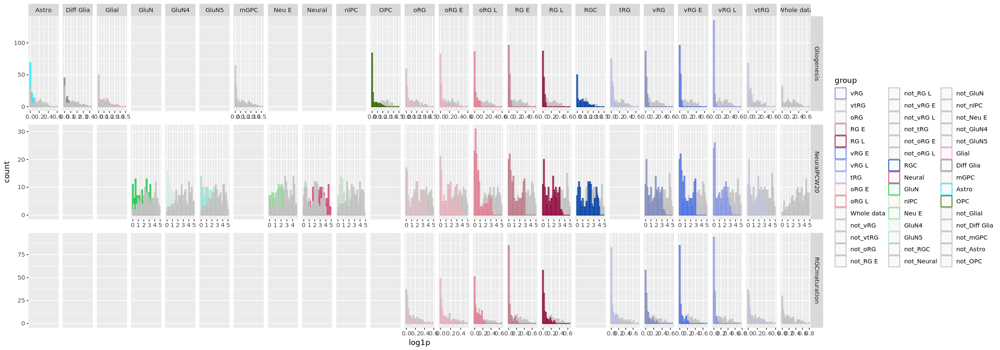

In [21]:
fig(20,7)
ggplot(psss, aes(x=log1p, group=group, color=group)) +
    geom_histogram(fill='transparent', position="identity", alpha=0.5) + 
    facet_grid2(cols=vars(cell.type), vars(sampleFct), scales='free', independent='x') + 
    scale_color_manual(values=pal)

### z-score of  log1p scores

In [22]:
## Apply z-score norm

In [23]:
psss <- psss %>% group_by(sample, group) %>% mutate(z.log1p=(log1p-mean(log1p, na.rm=T)/sd(log1p, na.rm=T)))

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
“Removed 1 rows containing non-finite values (stat_bin).”


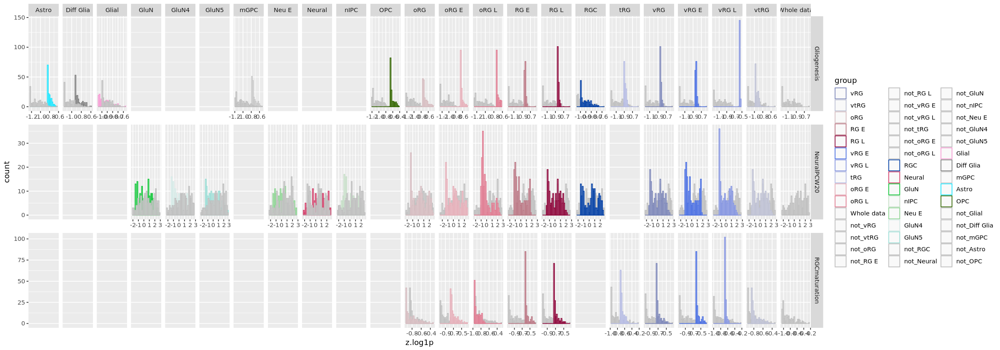

In [24]:
fig(20,7)
ggplot(psss, aes(x=z.log1p, group=group, color=group)) +
    geom_histogram(fill='transparent', position="identity", alpha=0.5) + 
    facet_grid2(cols=vars(cell.type), vars(sampleFct), scales='free', independent='x') + 
    scale_color_manual(values=pal)

### relative to group max log1p scores

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
“Removed 1 rows containing non-finite values (stat_bin).”


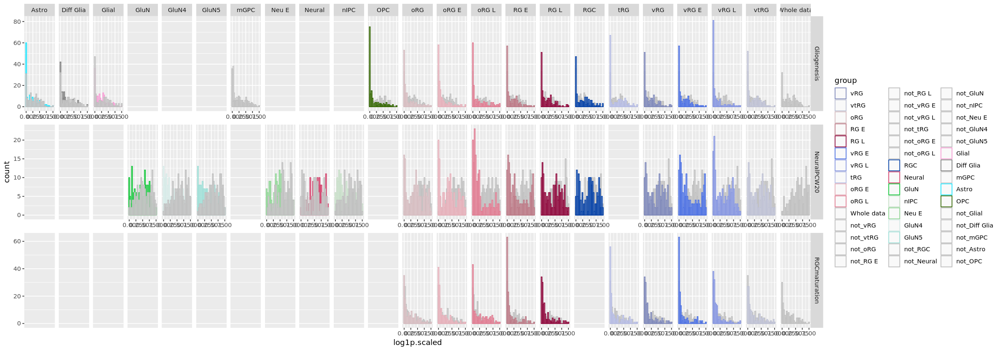

In [25]:
fig(20,7)
ggplot(psss, aes(x=log1p.scaled, group=group, color=group)) +
    geom_histogram(fill='transparent', position="identity", alpha=0.5) + 
    facet_grid2(cols=vars(cell.type), vars(sampleFct), scales='free', independent='x') + 
    scale_color_manual(values=pal)

## Heatmaps for clustering of genes

### Mixed samples, no RGC from neurogenesis

In [14]:
heat.psss <- subset(psss, group %in% sel.celltypes & sample != 'RGCmaturation')
heat.psss <- subset(heat.psss, !(sample == 'NeuralPCW20' & grepl('RG', group)))

In [15]:
table (heat.psss[,c('group', 'sample')])

       sample
group   Gliogenesis NeuralPCW20
  Astro         158           0
  GluN4           0         164
  GluN5           0         164
  mGPC          158           0
  Neu E           0         164
  nIPC            0         164
  OPC           158           0
  oRG E         158           0
  oRG L         158           0
  tRG           158           0
  vRG E         158           0
  vRG L         158           0

In [16]:
tops <- (heat.psss %>% group_by(group) %>% slice_max(order_by=log1p, n=10))$gene

In [17]:
heat.mat <- reshape2::dcast(heat.psss, formula = 'gene ~ sampleFct + groupFct', value.var='log1p.scaled')
heat.mat[is.na(heat.mat)] <- 0
gene.cl <- hclust(dist(heat.mat[,-1]))
gene.levs <- heat.mat$gene[gene.cl$order]

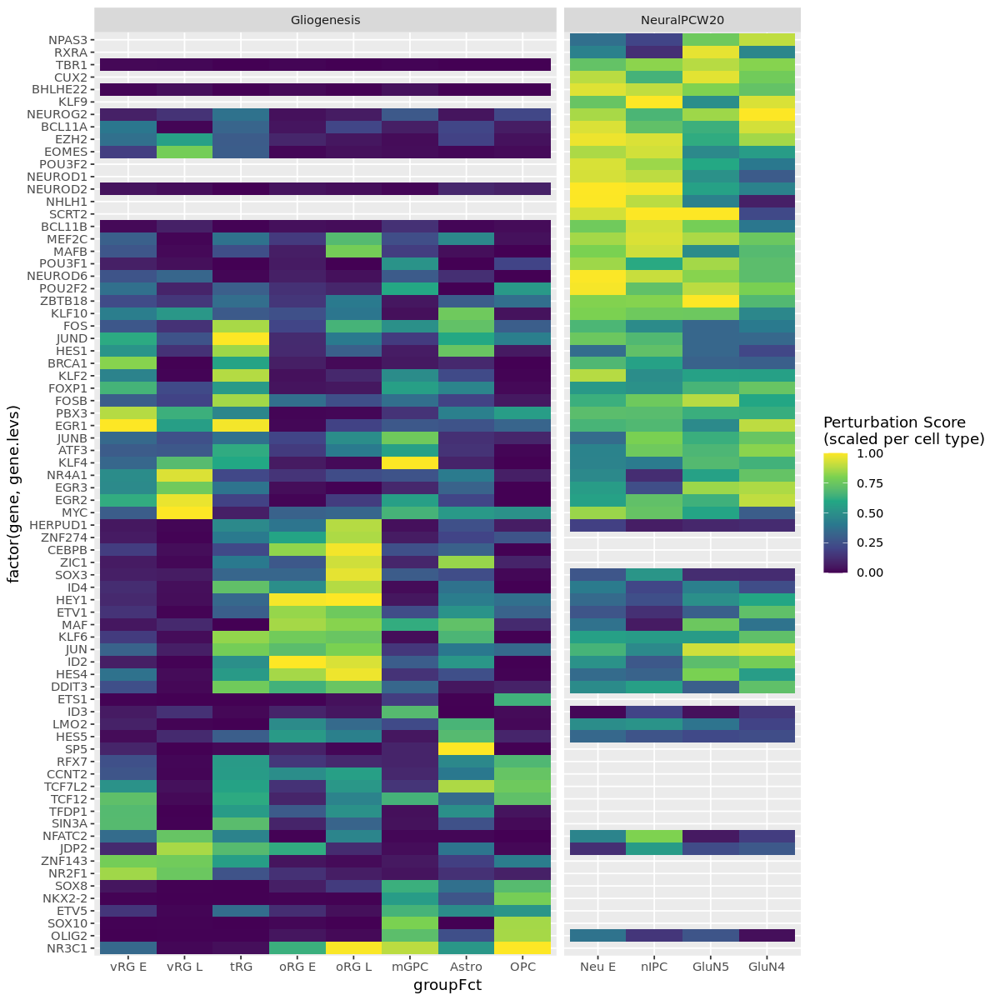

In [18]:
fig(10,10)

ggplot(
    subset(heat.psss, gene %in% tops),
    aes(x=groupFct,
        y=factor(gene, gene.levs),
        fill=log1p.scaled)) + 
geom_tile() + 
facet_grid(cols=vars(sampleFct), scales='free', space='free') + 
scale_fill_viridis_c('Perturbation Score\n(scaled per cell type)')


### Separate samples

In [19]:
heat.psss <- subset(psss, group %in% sel.celltypes & sample != 'RGCmaturation')
# heat.psss <- subset(heat.psss, !(sample == 'NeuralPCW20' & grepl('RG', group)))

In [20]:
table (heat.psss[,c('group', 'sample')])

       sample
group   Gliogenesis NeuralPCW20
  Astro         158           0
  GluN4           0         164
  GluN5           0         164
  mGPC          158           0
  Neu E           0         164
  nIPC            0         164
  OPC           158           0
  oRG E         158         164
  oRG L         158         164
  tRG           158           0
  vRG E         158         164
  vRG L         158         164

In [21]:
tops <- (heat.psss %>% group_by(group) %>% slice_max(order_by=log1p, n=10))$gene

In [27]:
heat.mat <- reshape2::dcast(heat.psss, formula = 'gene ~ sampleFct + groupFct', value.var='log1p.scaled')
heat.mat[is.na(heat.mat)] <- 0
gene.cl <- hclust(dist(heat.mat[,-1]))
gene.levs <- heat.mat$gene[gene.cl$order]

In [28]:
gene.levs

[1] "NR2F1"    "ZNF143"   "TCF12"    "TCF7L2"   "CCNT2"    "RFX7"    
  [7] "NPAS1"    "PRRX1"    "ETS1"     "EPAS1"    "NKX6-2"   "HNF4G"   
 [13] "MITF"     "PRDM1"    "HNF4A"    "PTF1A"    "POU2F3"   "GBX2"    
 [19] "KLF1"     "IKZF3"    "POU6F2"   "SP100"    "TBX22"    "HMX1"    
 [25] "IRX1"     "IRX2"     "NKX2-1"   "DBX2"     "SP9"      "GRHL1"   
 [31] "ETS2"     "GSX2"     "BCL3"     "NFE2"     "BATF3"    "NKX2-3"  
 [37] "NHLH2"    "HOXB7"    "FOXF1"    "SOX17"    "VENTX"    "FOXD4"   
 [43] "GFI1B"    "MSX2"     "SIM2"     "OSR1"     "AIRE"     "TLX2"    
 [49] "ESRRB"    "GATA1"    "RUNX3"    "EBF1"     "ISL2"     "PITX3"   
 [55] "RAX"      "ZNF467"   "ELF3"     "ZNF320"   "LHX4"     "AHRR"    
 [61] "MECOM"    "ONECUT1"  "TBX3"     "CRX"      "MEOX2"    "ELK3"    
 [67] "HIVEP2"   "NR3C2"    "LHX5"     "NR6A1"    "TCF7L1"   "ARX"     
 [73] "CREB3L1"  "LHX1"     "RREB1"    "TFAP2D"   "DLX2"     "SCX"     
 [79] "MSX1"     "ZKSCAN4"  "ZNF713"   "DLX1"     "DLX5"     "LEF1"    
 [85] "HEY2"     "HMGA2"    "FOXJ1"    "SIX5"     "SP5"      "SIN3A"   
 [91] "TFDP1"    "KLF7"     "RORB"     "FOXM1"    "MYBL1"    "E2F1"    
 [97] "MYBL2"    "NFIL3"    "BHLHE41"  "FEZF2"    "NR2F2"    "CENPB"   
[103] "HMGA1"    "ZNF436"   "ETV1"     "MAF"      "ZIC1"     "CEBPB"   
[109] "PLAGL1"   "ZNF274"   "NFE2L1"   "HERPUD1"  "SOX3"     "NR3C1"   
[115] "ARID5B"   "ETV5"     "GSX1"     "OLIG1"    "OLIG2"    "SOX10"   
[121] "NKX2-2"   "SOX8"     "DDIT3"    "HEY1"     "HES4"     "ID2"     
[127] "JUN"      "KLF6"     "KLF9"     "NR4A2"    "NR4A3"    "MAFB"    
[133] "HIVEP3"   "MEF2C"    "JDP2"     "NFATC2"   "HES5"     "LMO2"    
[139] "ID4"      "SOX9"     "BACH2"    "TFAP2C"   "TBX1"     "DBP"     
[145] "PPARGC1A" "HSF4"     "ONECUT2"  "NPAS4"    "PPARA"    "PROX1"   
[151] "ARID3A"   "HDX"      "KLF8"     "SOX6"     "GLI3"     "NFE2L2"  
[157] "BBX"      "ELF1"     "CREB5"    "ENO1"     "NPAS3"    "XBP1"    
[163] "RXRG"     "ZNF667"   "IKZF4"    "ZFHX3"    "POU3F4"   "RXRA"    
[169] "ZNF331"   "FOXP2"    "TEAD1"    "E2F7"     "E2F8"     "NFATC4"  
[175] "PAX6"     "SOX2"     "ZIC2"     "ZIC5"     "GLIS3"    "NFKB2"   
[181] "BHLHE40"  "SMAD3"    "CEBPD"    "ID3"      "HES1"     "FOS"     
[187] "JUND"     "ASCL1"    "YBX1"     "ZEB1"     "MYC"      "IRF1"    
[193] "FOSB"     "MYCN"     "MAFF"     "ATF3"     "JUNB"     "EGR1"    
[199] "PBX3"     "EGR3"     "NR4A1"    "EGR2"     "ID1"      "KLF4"    
[205] "NEUROG1"  "KLF12"    "NEUROD4"  "NHLH1"    "POU3F2"   "TCF4"    
[211] "NEUROD1"  "NEUROD2"  "MTF1"     "NFIA"     "TBR1"     "BCL11B"  
[217] "SCRT2"    "POU3F1"   "BHLHE22"  "CUX2"     "EOMES"    "SOX4"    
[223] "NFIB"     "REL"      "BCL11A"   "INSM1"    "NEUROG2"  "POU2F2"  
[229] "SOX11"    "ZBTB18"   "KLF10"    "EZH2"     "NEUROD6"  "BRCA1"   
[235] "TFDP2"    "FOXP1"    "KLF2"

Warning message:
“Columns cannot have free space if axes are independent.”


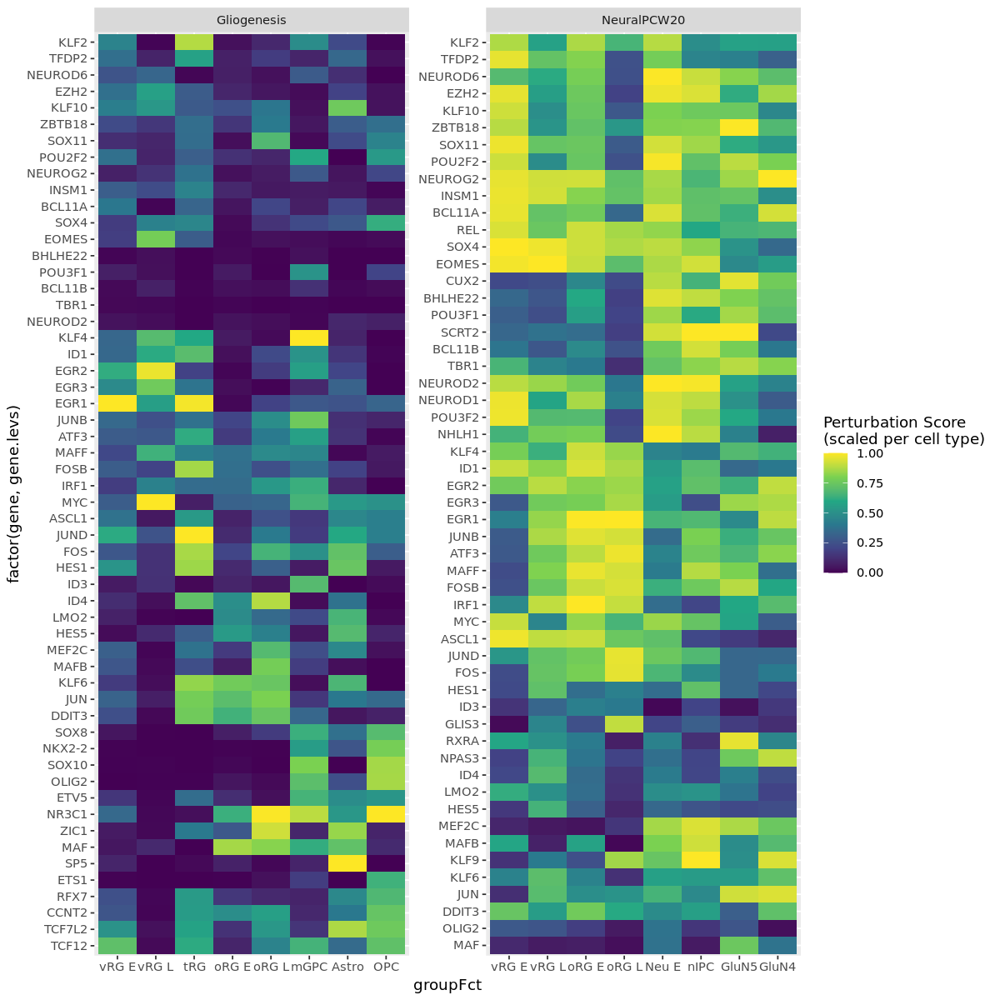

In [29]:
fig(10,10)

ggplot(
    subset(heat.psss, gene %in% tops),
    aes(x=groupFct,
        y=factor(gene, gene.levs),
        fill=log1p.scaled)) + 
geom_tile() + 
facet_grid2(cols=vars(sampleFct), scales='free', space='free', independent='y') + 
scale_fill_viridis_c('Perturbation Score\n(scaled per cell type)')


Warning message:
“Rows cannot have free space if axes are independent.”


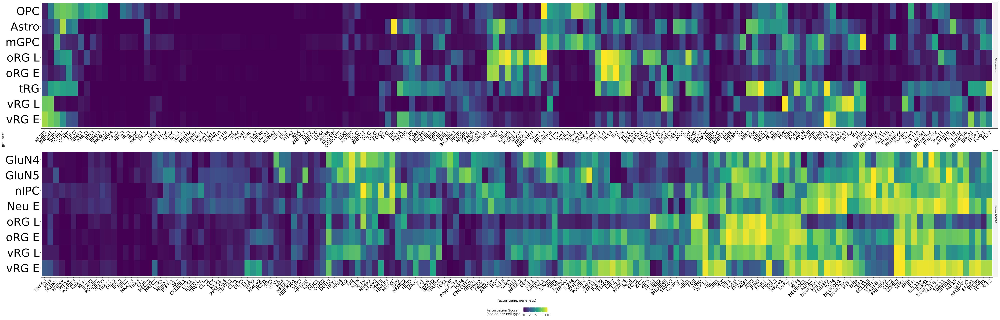

In [30]:
fig(50,16)

ggplot(
    heat.psss,
    aes(y=groupFct,
        x=factor(gene, gene.levs),
        fill=log1p.scaled)) + 
geom_tile() + 
theme_pubr(legend='bottom') + 
facet_grid2(rows=vars(sampleFct), scales='free', space='free', independent='x') + 
scale_fill_viridis_c('Perturbation Score\n(scaled per cell type)') + 
theme(axis.text.x = element_text(size=16, angle=45, hjust=1),
      axis.text.y = element_text(size=40))


In [31]:
gene.clusters <- lapply(2:30, function(x){setNames(cutree(gene.cl, k=x), gene.levs)})
names(gene.clusters) <- paste0('k_', 2:30)

In [32]:
gene.clusters <- data.frame(gene.clusters)
gene.clusters$gene <- rownames(gene.clusters)

In [33]:
heat.psss <- merge(heat.psss, gene.clusters, by='gene', all.x=T, all.y=F)

In [34]:
heat.psss

gene,group,score,sample,groupsample,log1p,cell.type,groupFct,sampleFct,log1p.scaled,⋯,k_21,k_22,k_23,k_24,k_25,k_26,k_27,k_28,k_29,k_30
<chr>,<chr>,<dbl>,<chr>,<chr>,<dbl>,<chr>,<fct>,<fct>,<dbl>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
AHRR,mGPC,4.888043e-03,Gliogenesis,mGPC (Gliogenesis),4.876135e-03,mGPC,mGPC,Gliogenesis,1.931570e-02,⋯,1,1,1,1,1,1,1,1,1,1
AHRR,oRG E,5.227614e-04,Gliogenesis,oRG E (Gliogenesis),5.226248e-04,oRG E,oRG E,Gliogenesis,2.865643e-03,⋯,1,1,1,1,1,1,1,1,1,1
AHRR,Astro,6.294757e-06,Gliogenesis,Astro (Gliogenesis),6.294738e-06,Astro,Astro,Gliogenesis,3.272288e-05,⋯,1,1,1,1,1,1,1,1,1,1
AHRR,vRG E,1.766515e-04,Gliogenesis,vRG E (Gliogenesis),1.766359e-04,vRG E,vRG E,Gliogenesis,3.083077e-03,⋯,1,1,1,1,1,1,1,1,1,1
AHRR,oRG L,1.236038e-04,Gliogenesis,oRG L (Gliogenesis),1.235962e-04,oRG L,oRG L,Gliogenesis,9.833107e-04,⋯,1,1,1,1,1,1,1,1,1,1
AHRR,tRG,0.000000e+00,Gliogenesis,tRG (Gliogenesis),0.000000e+00,tRG,tRG,Gliogenesis,0.000000e+00,⋯,1,1,1,1,1,1,1,1,1,1
AHRR,OPC,7.349585e-07,Gliogenesis,OPC (Gliogenesis),7.349582e-07,OPC,OPC,Gliogenesis,2.993754e-06,⋯,1,1,1,1,1,1,1,1,1,1
AHRR,vRG L,7.212561e-05,Gliogenesis,vRG L (Gliogenesis),7.212301e-05,vRG L,vRG L,Gliogenesis,1.827092e-03,⋯,1,1,1,1,1,1,1,1,1,1
AIRE,mGPC,9.896475e-05,Gliogenesis,mGPC (Gliogenesis),9.895986e-05,mGPC,mGPC,Gliogenesis,3.920069e-04,⋯,1,1,1,1,1,1,1,1,1,1


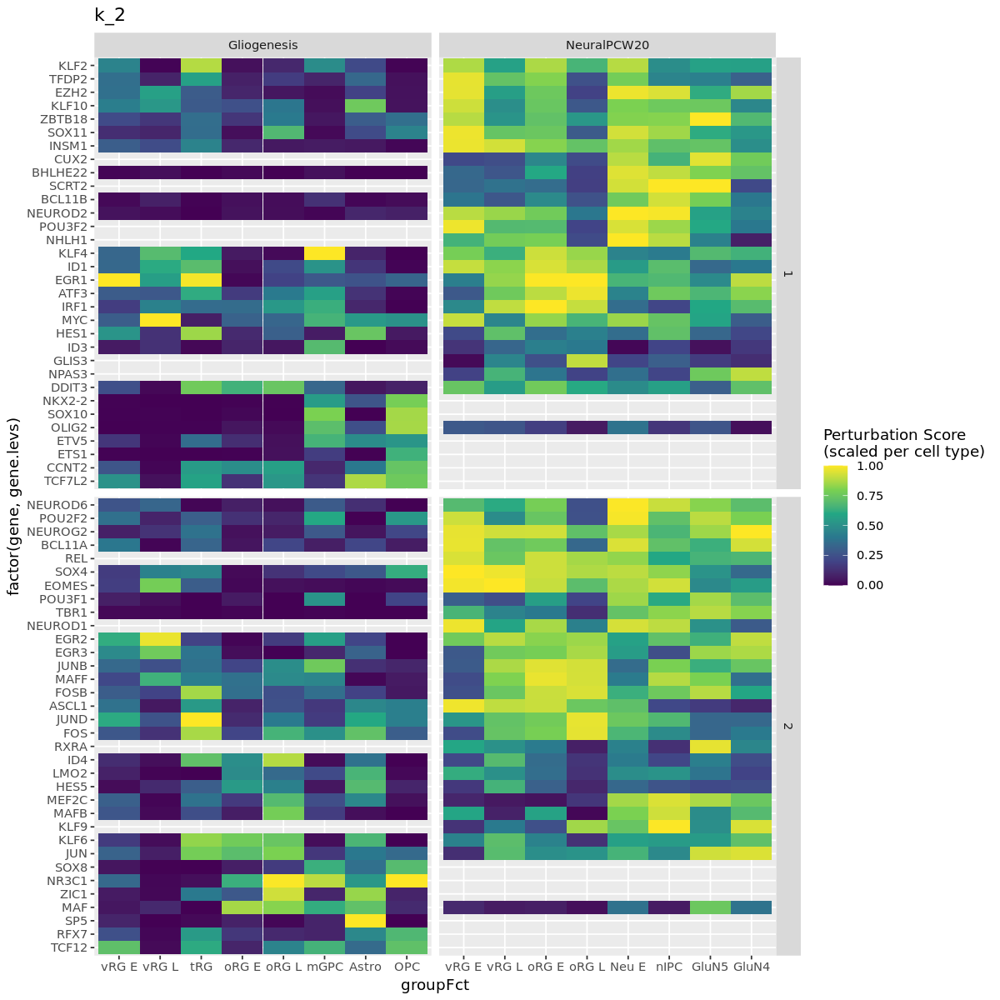

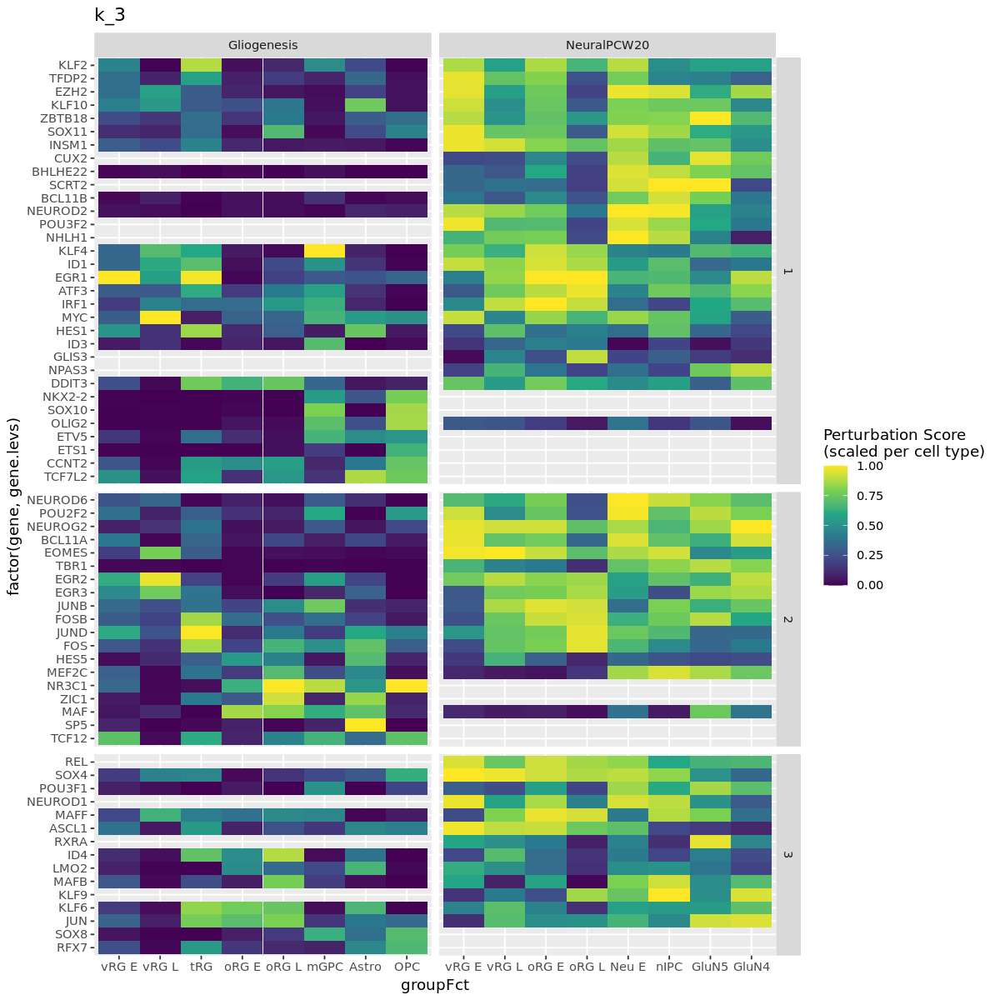

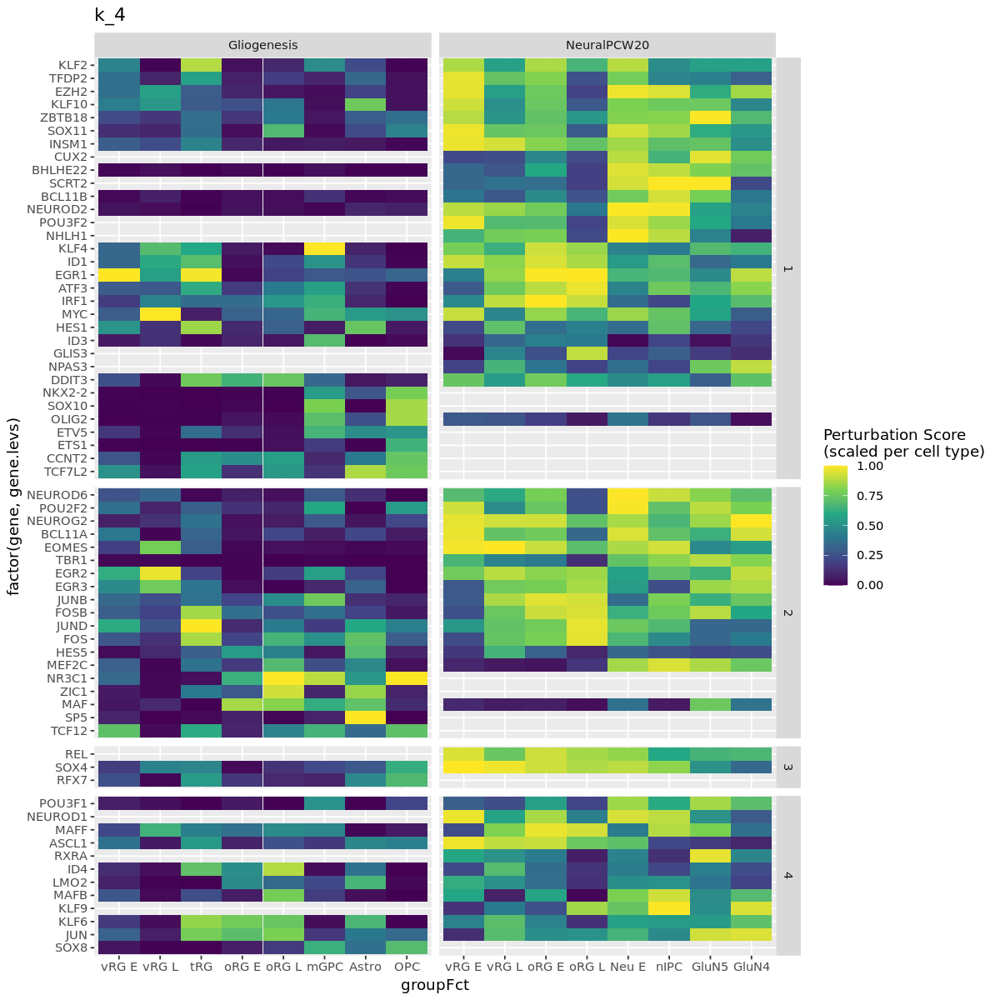

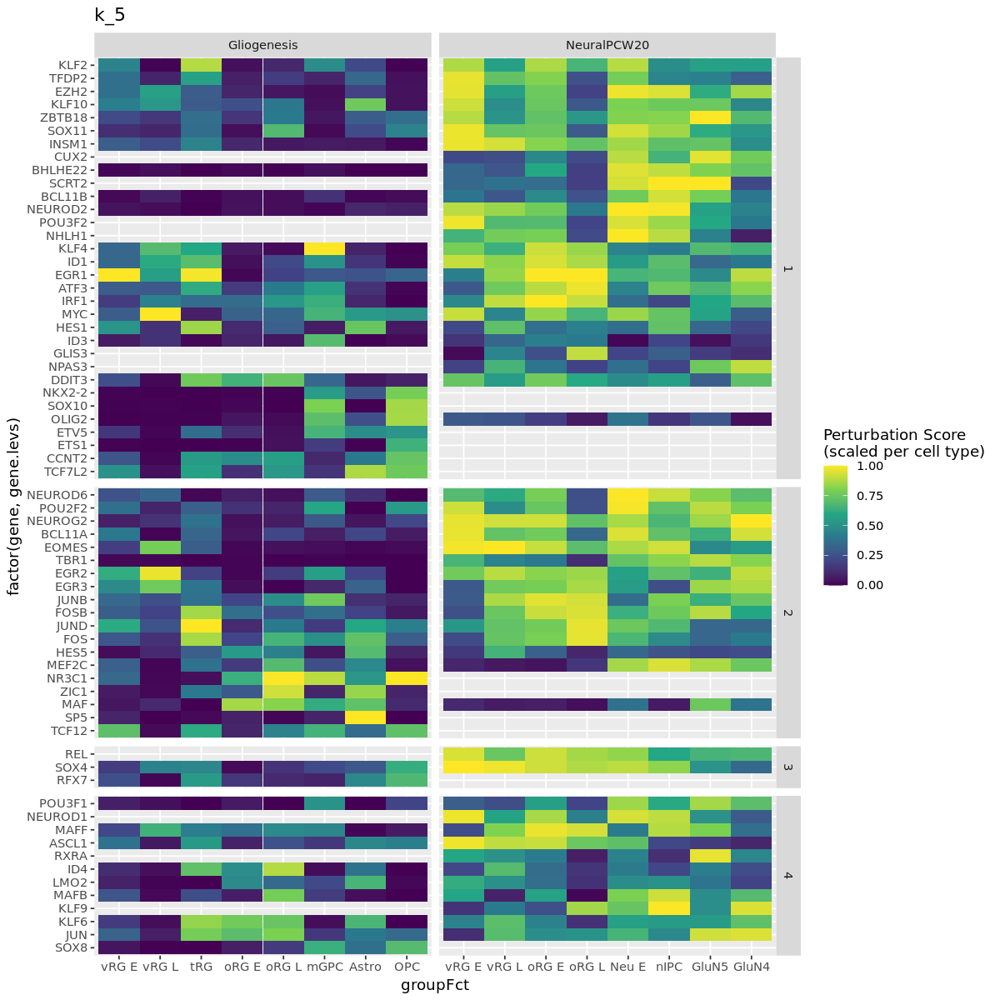

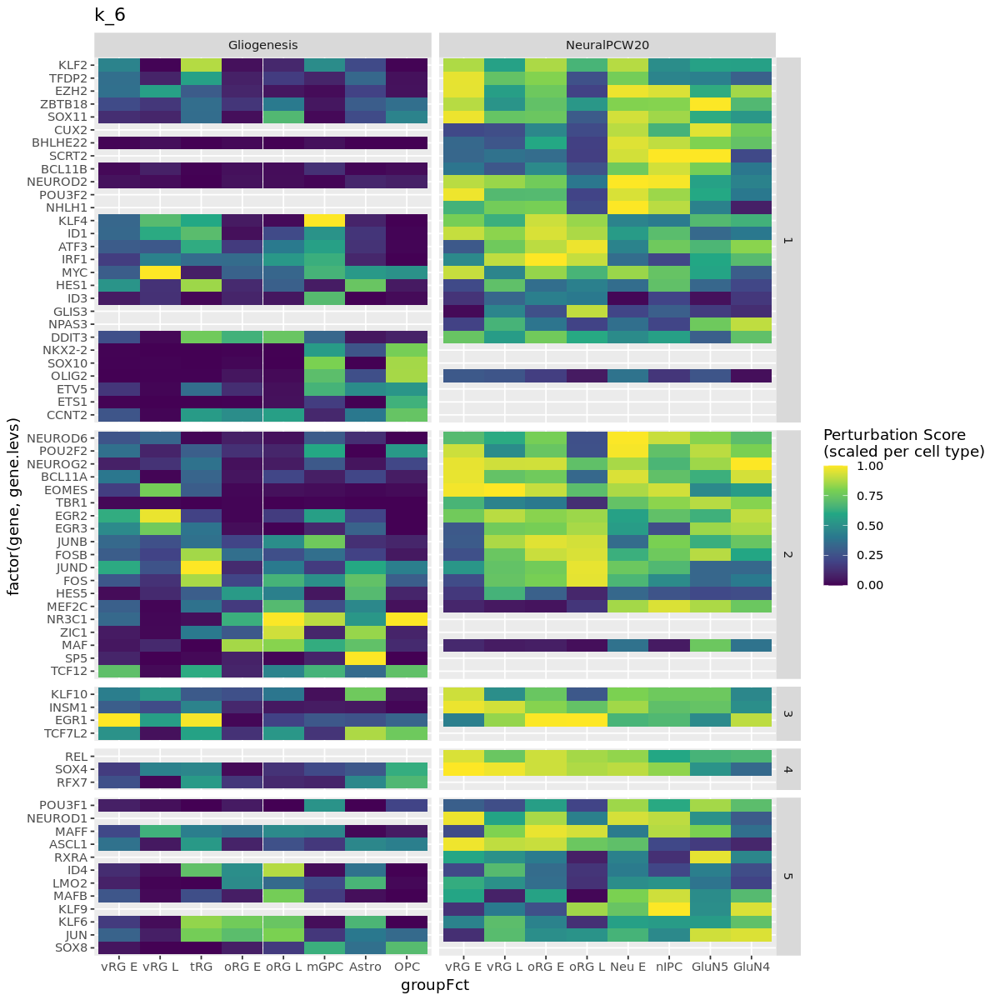

...

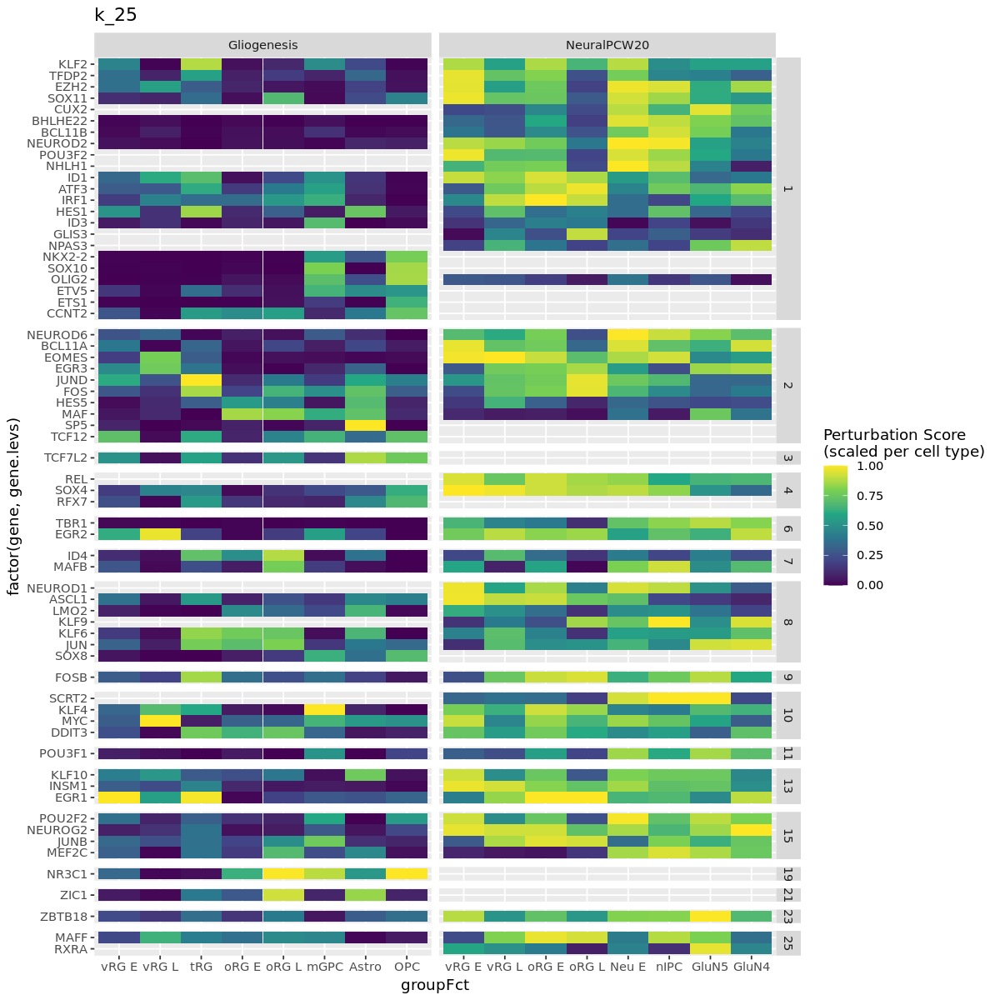

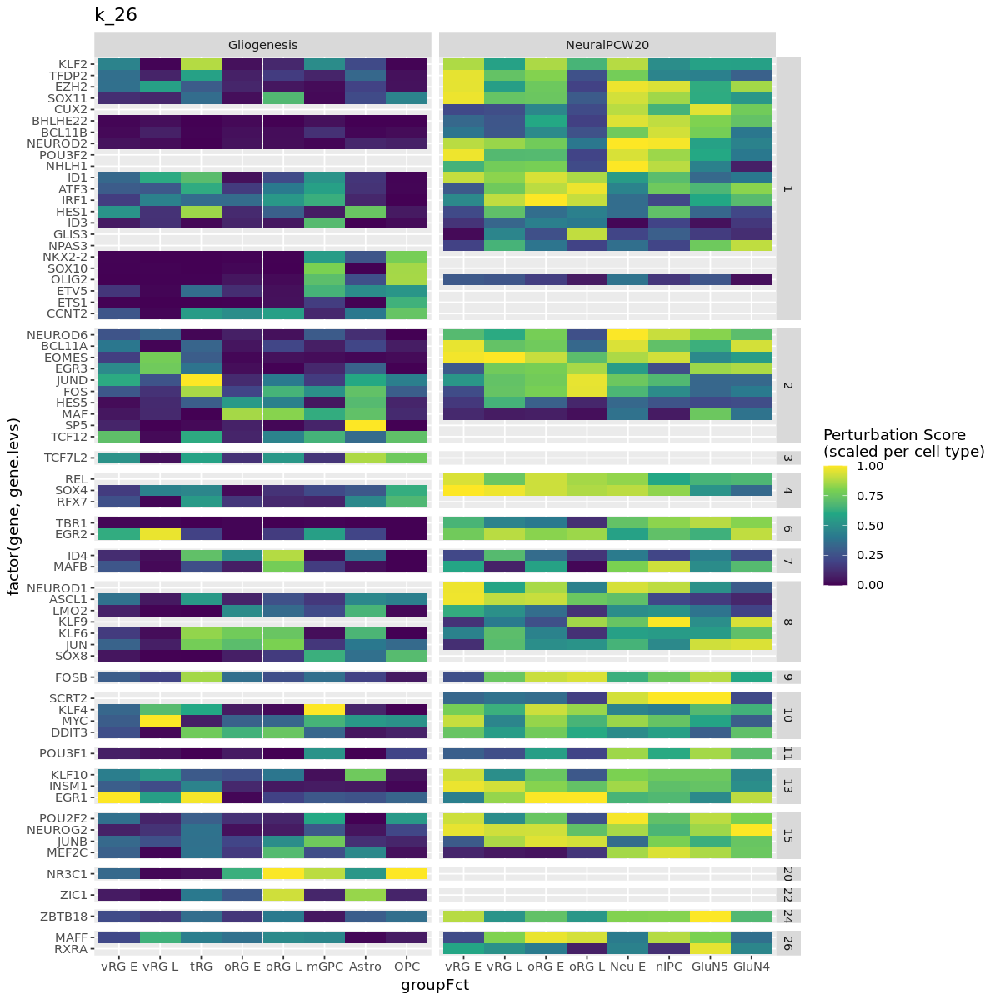

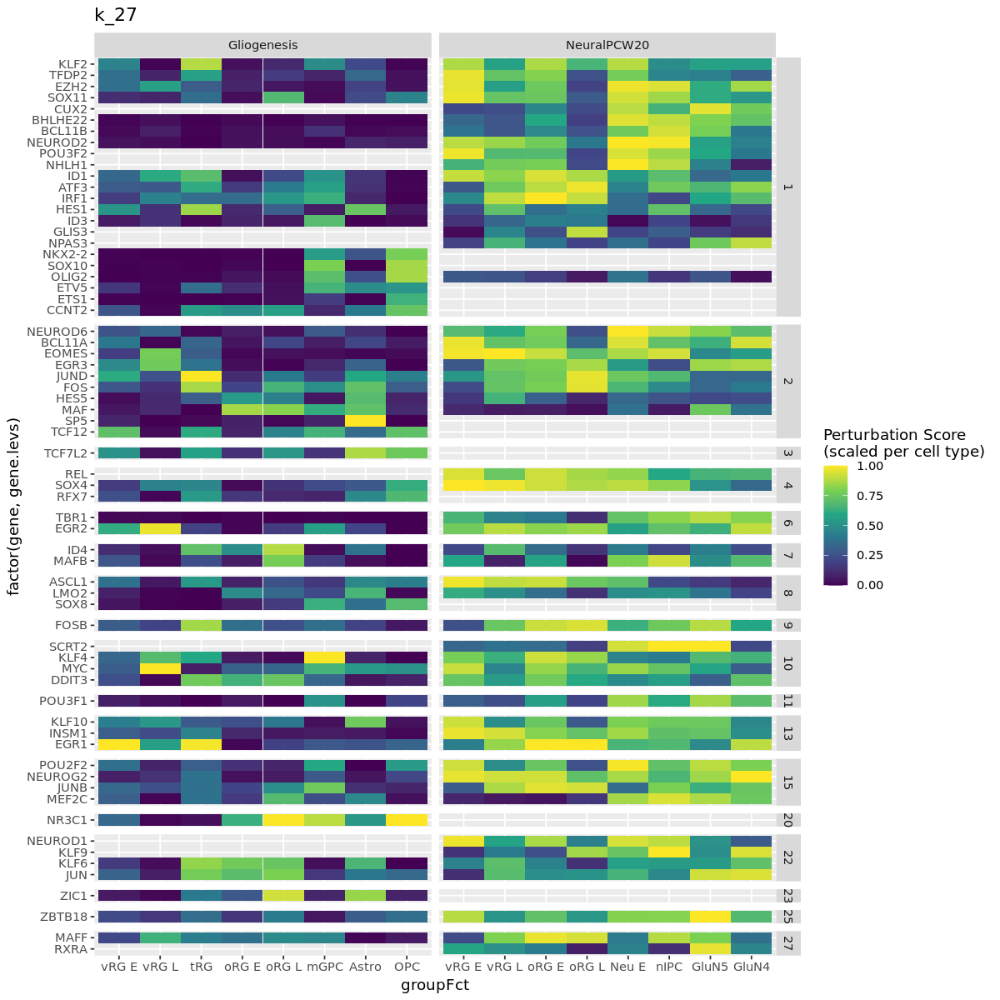

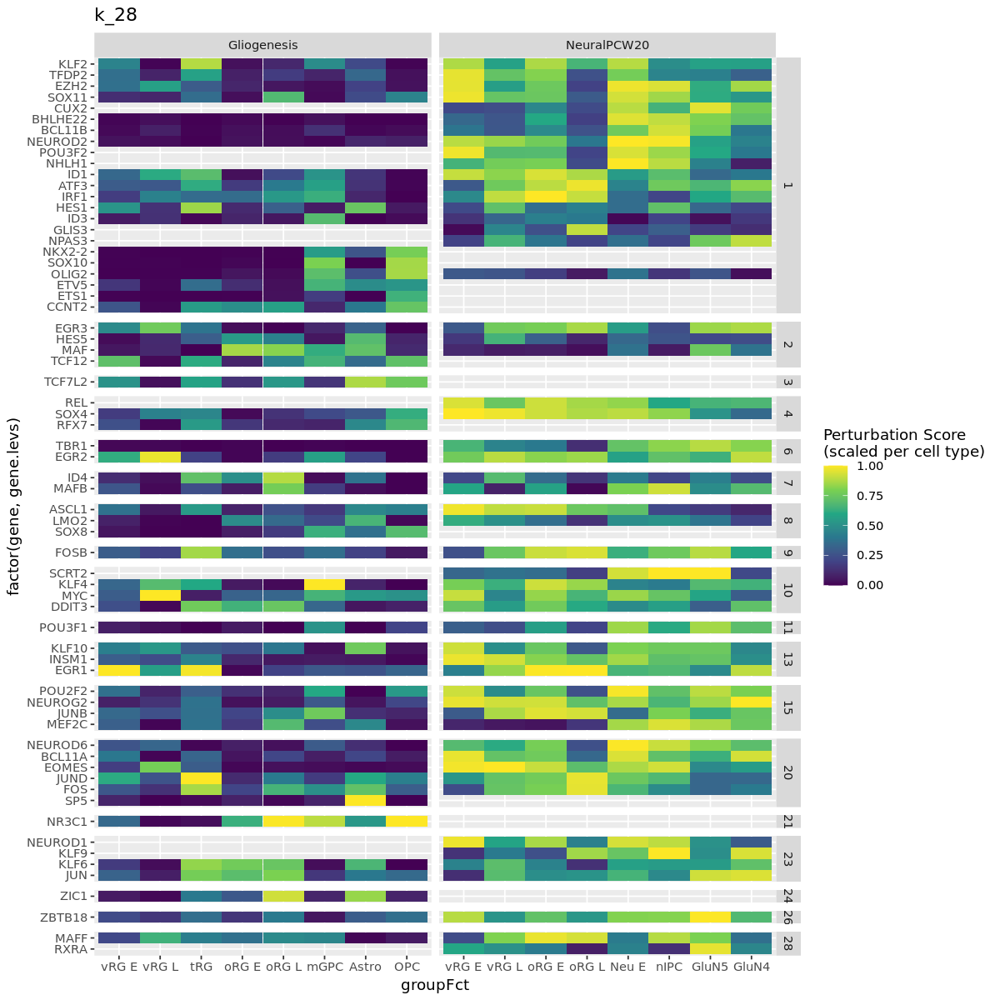

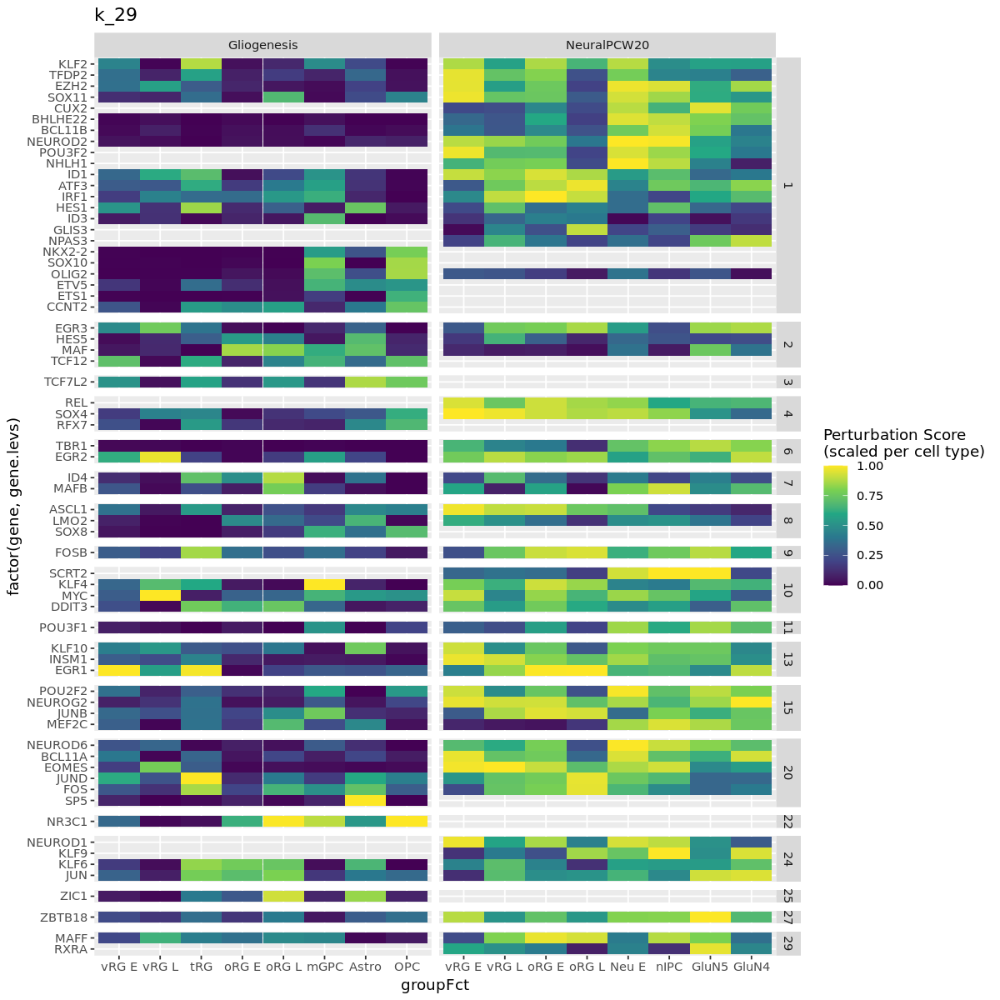

$k_2

$k_3

$k_4

$k_5

$k_6

$k_7

$k_8

$k_9

$k_10

$k_11

$k_12

$k_13

$k_14

$k_15

$k_16

$k_17

$k_18

$k_19

$k_20

$k_21

$k_22

$k_23

$k_24

$k_25

$k_26

$k_27

$k_28

$k_29

$k_30

$gene


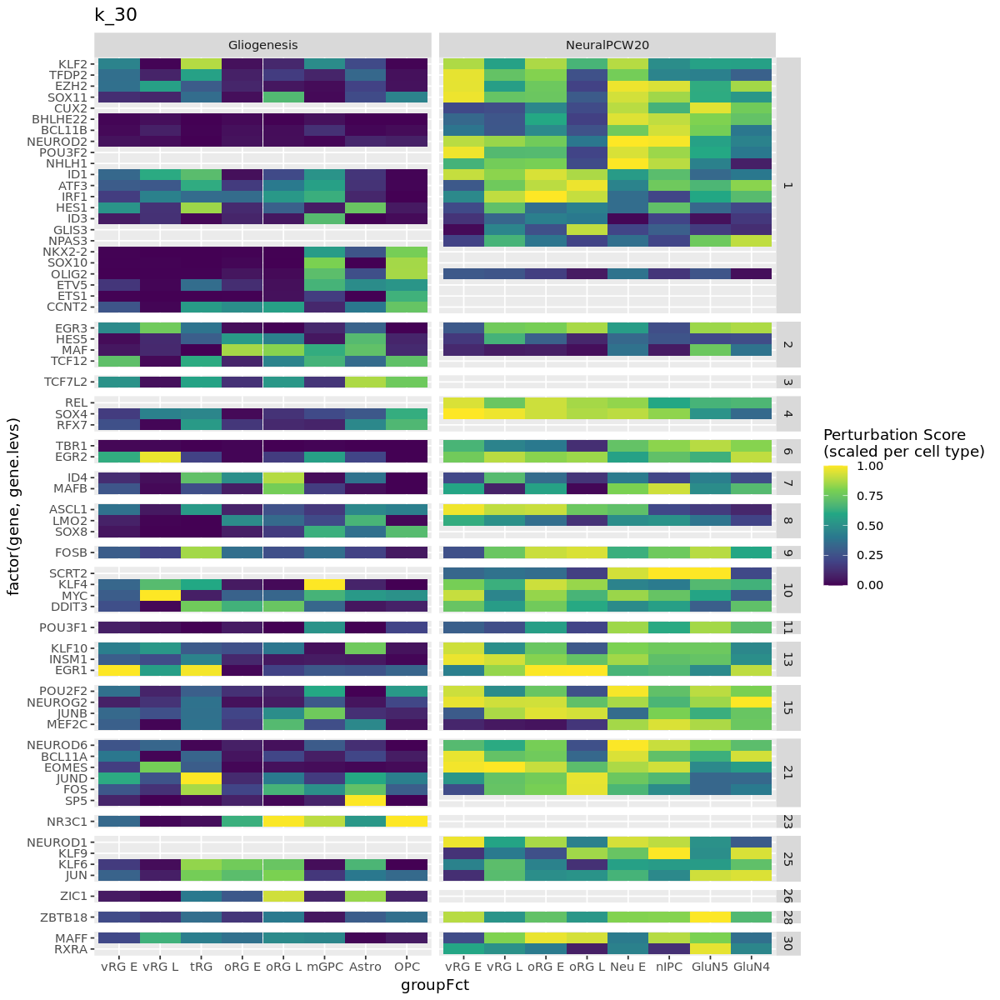

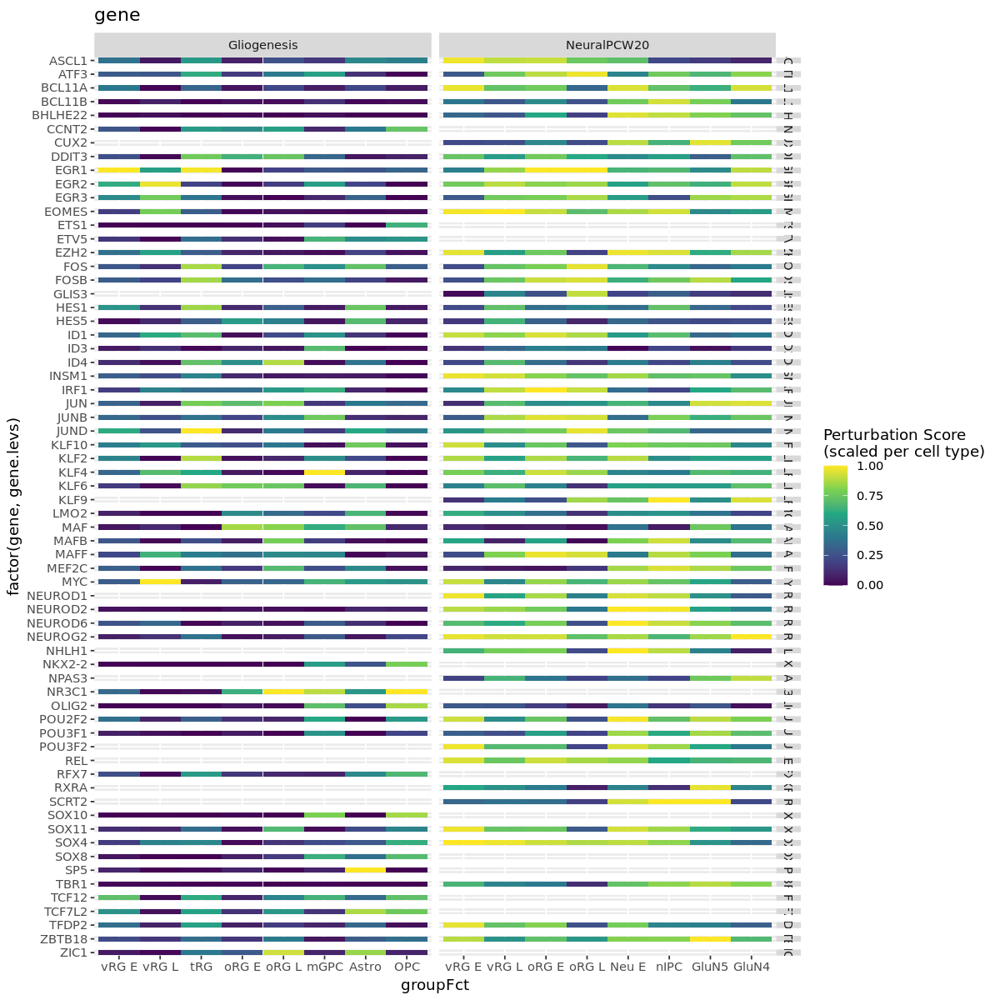

In [35]:
fig(10,10)

ps <- list()
for (col in colnames(gene.clusters)){
    heat.psss$gene.cl <- factor(heat.psss[,col, drop=T])
    p <-  ggplot(
        subset(heat.psss, gene %in% tops),
        aes(x=groupFct,
            y=factor(gene, gene.levs),
            fill=log1p.scaled)) + 
    geom_tile() + 
    facet_grid(cols=vars(sampleFct), 
               rows=vars(gene.cl),
               scales='free', space='free') + 
    ggtitle(col) + 
    scale_fill_viridis_c('Perturbation Score\n(scaled per cell type)')

    ps[[col]] <- p
    
}

ps

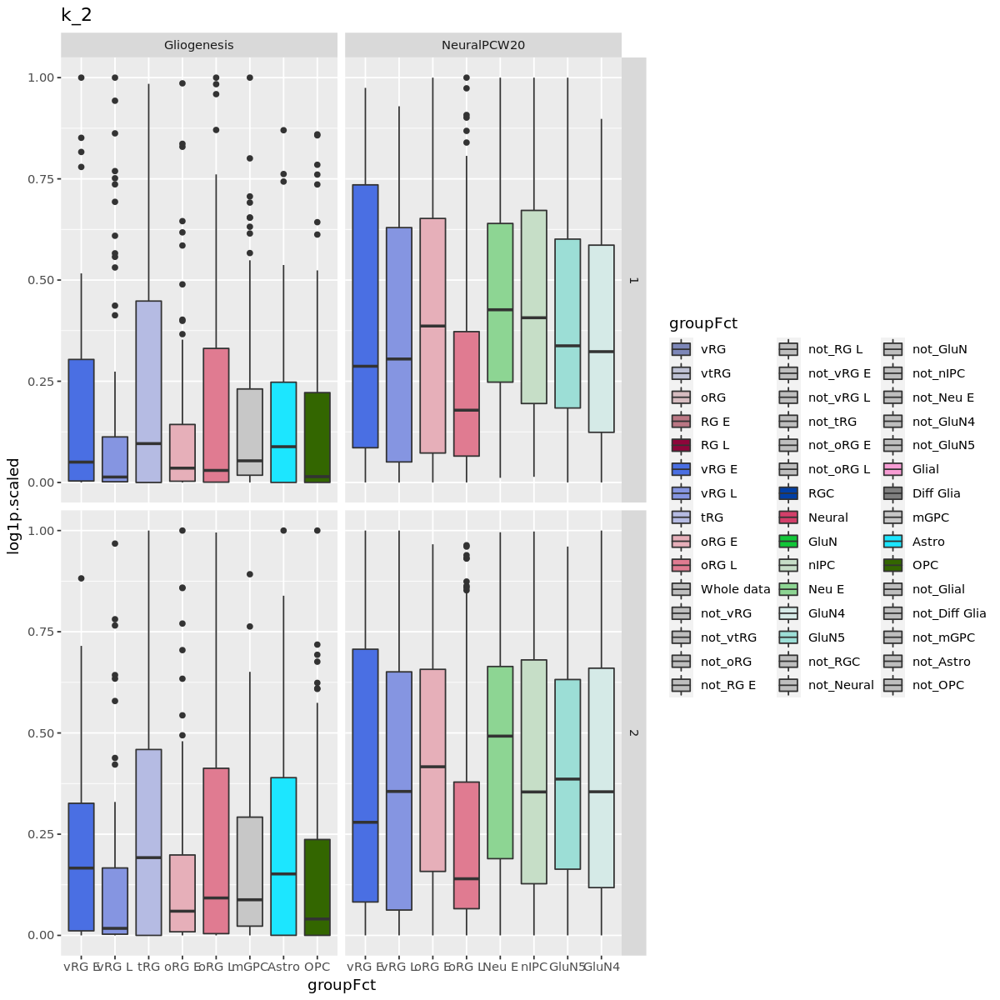

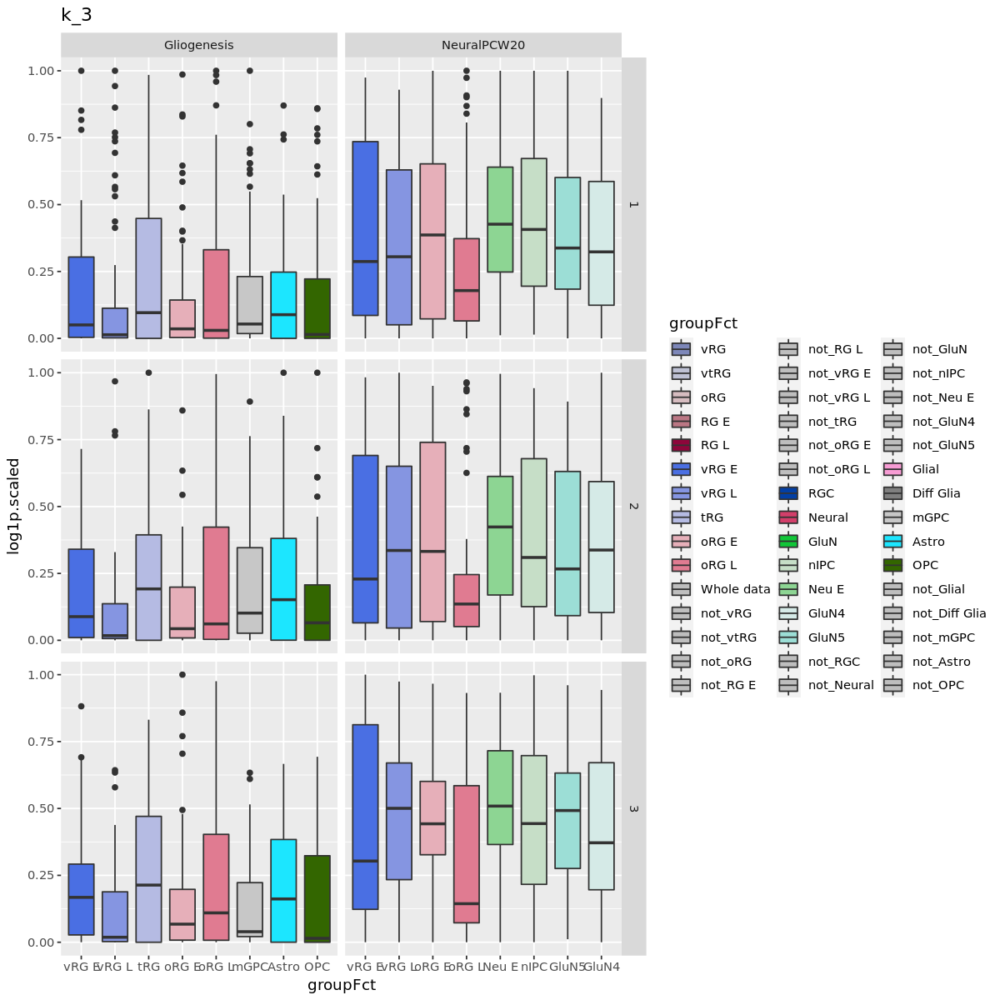

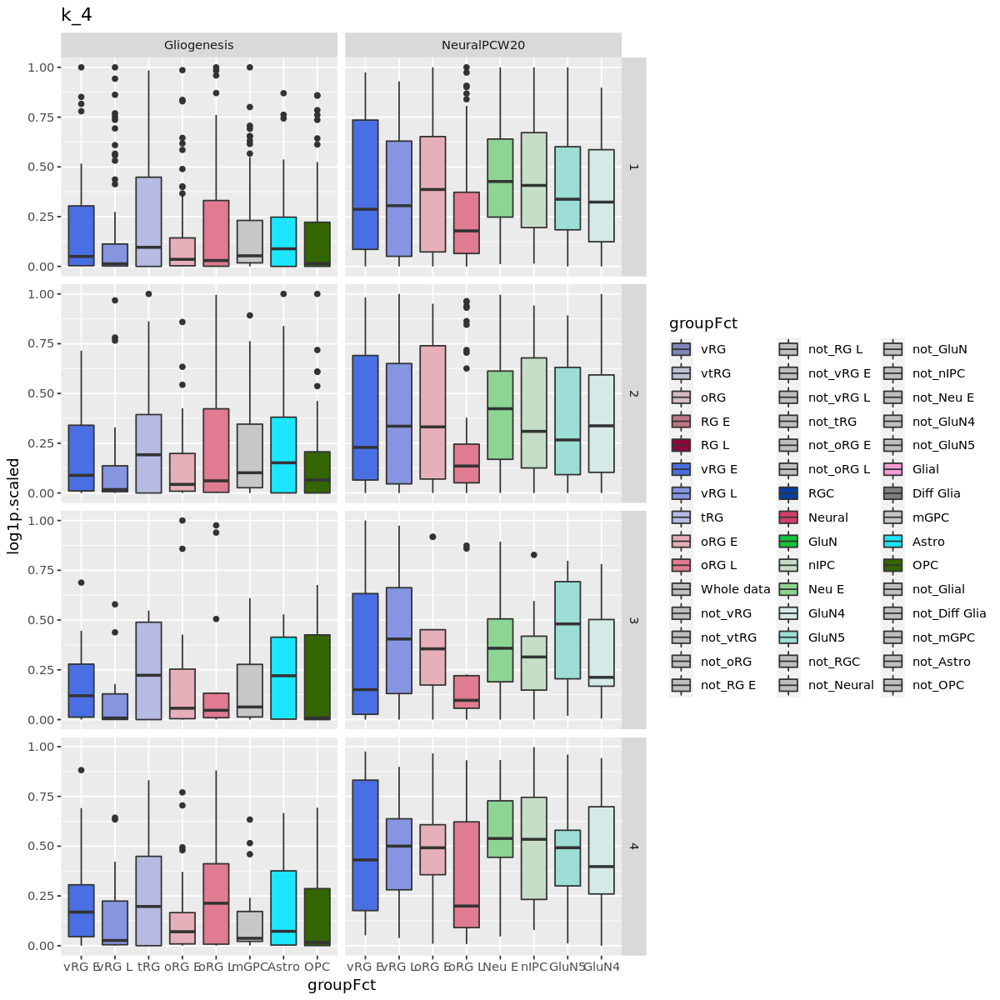

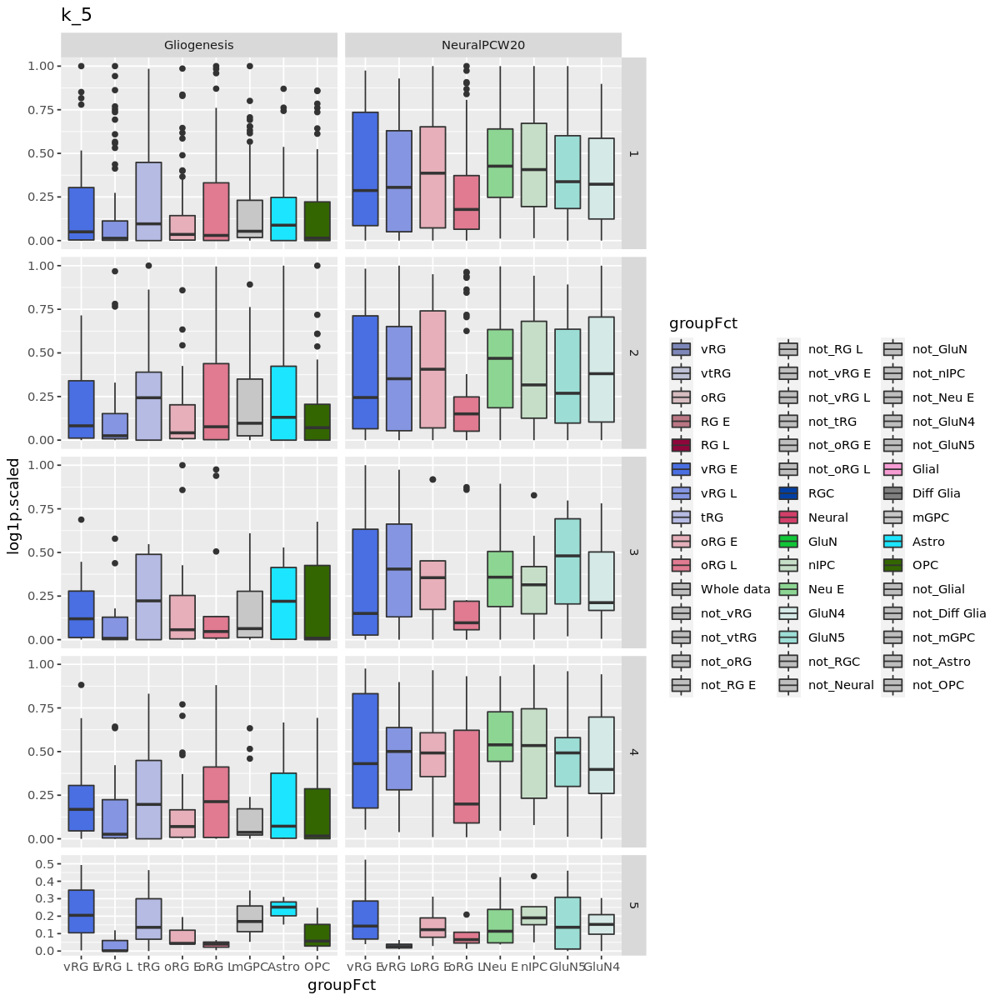

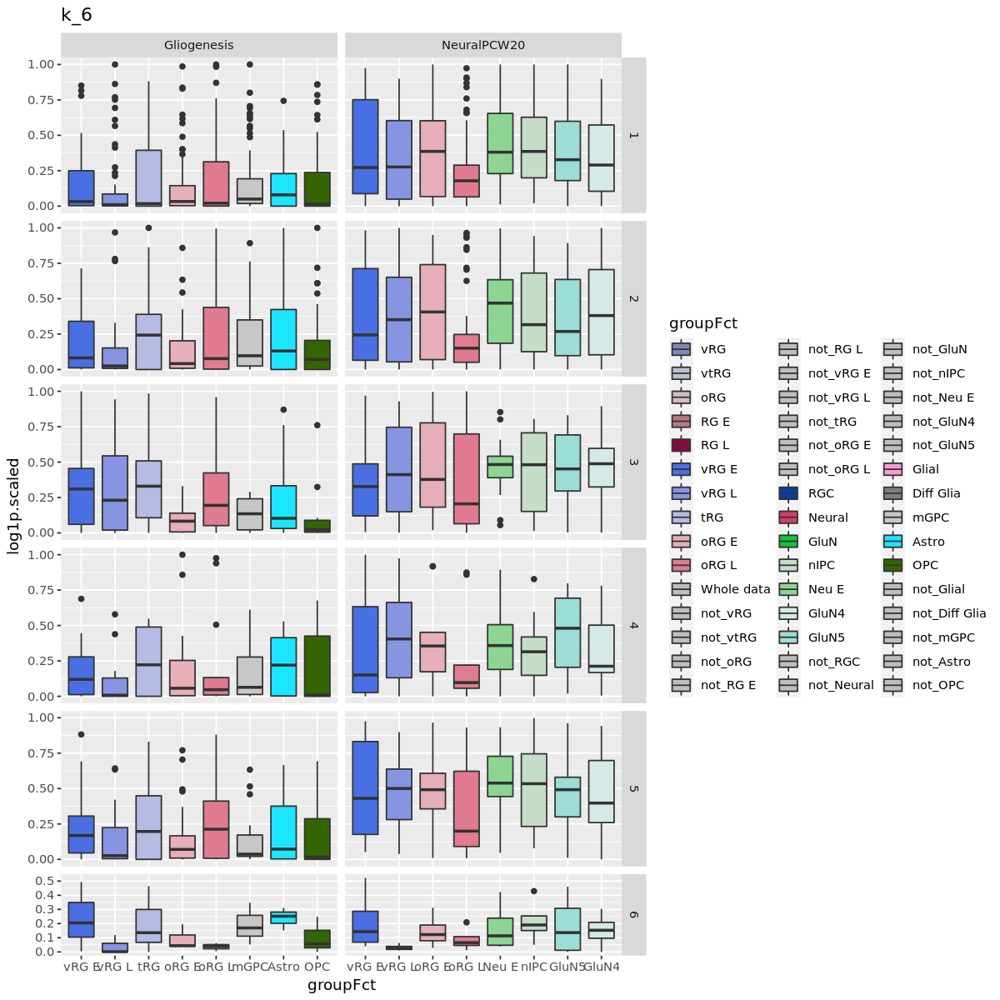

...

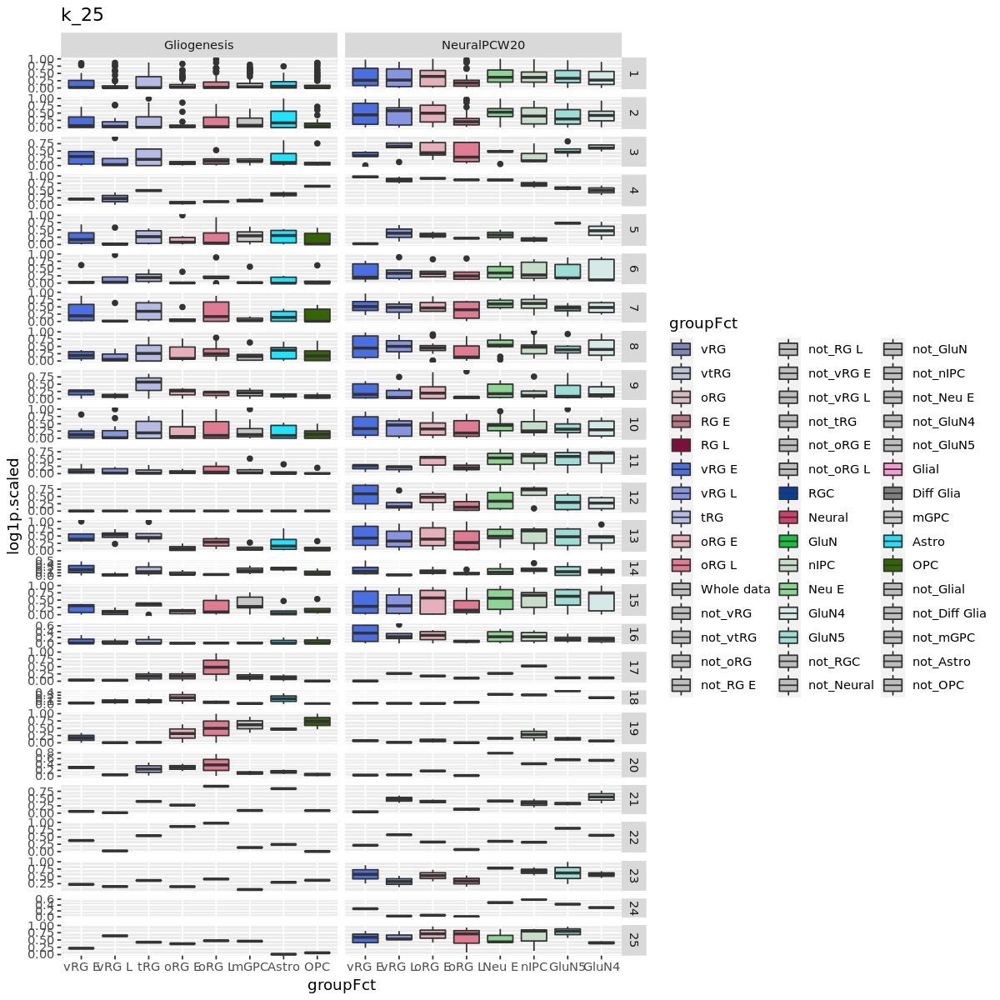

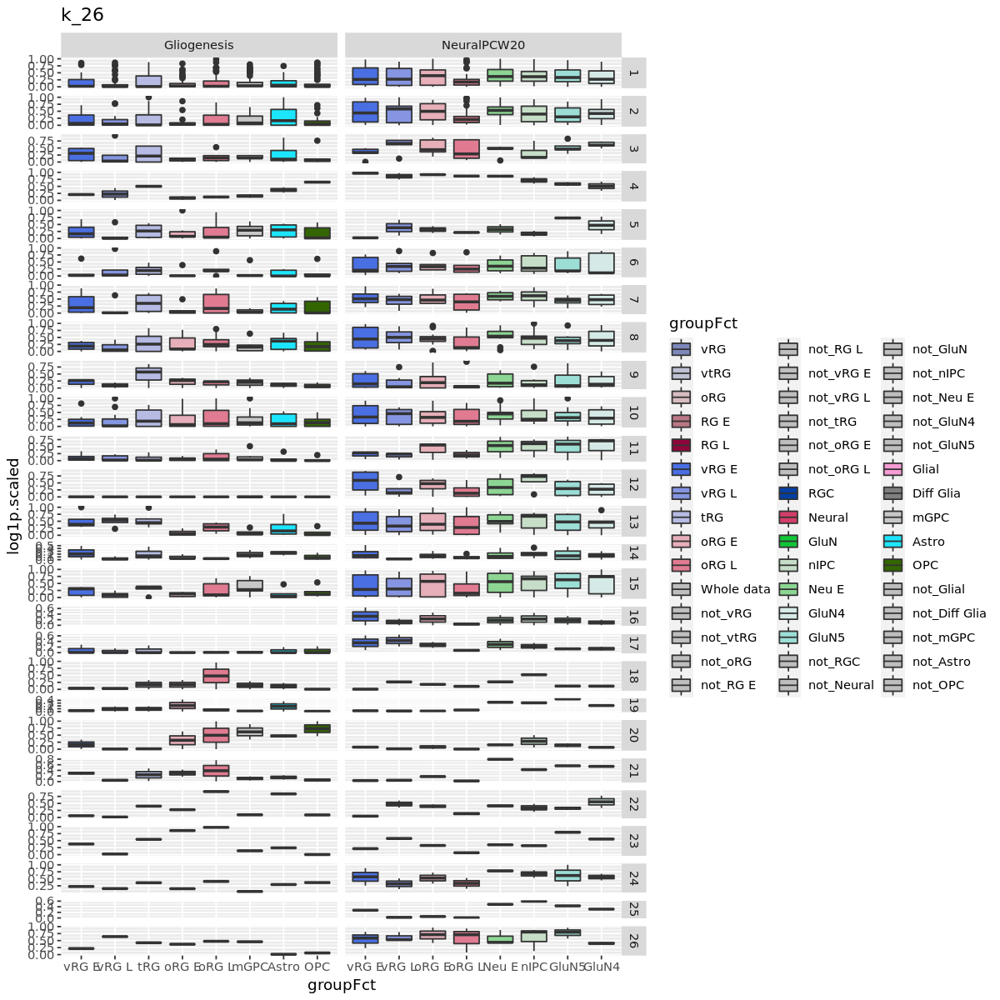

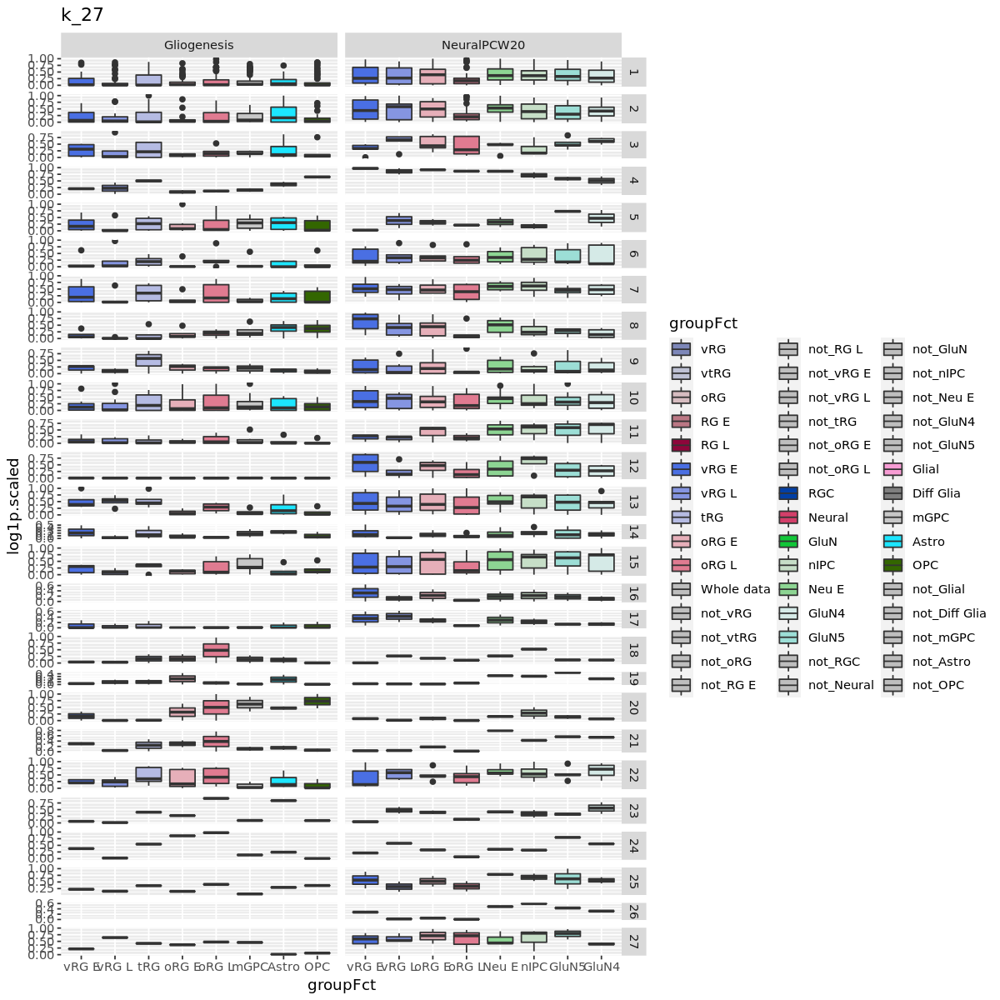

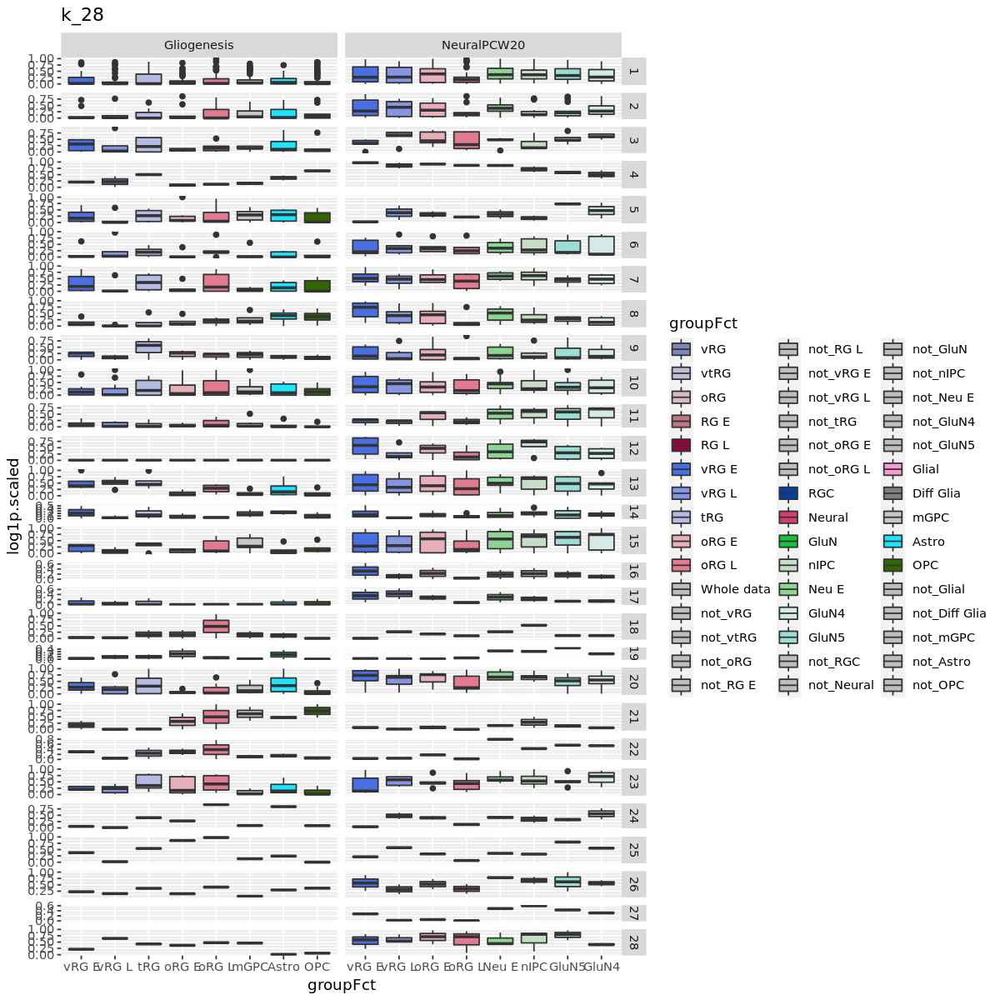

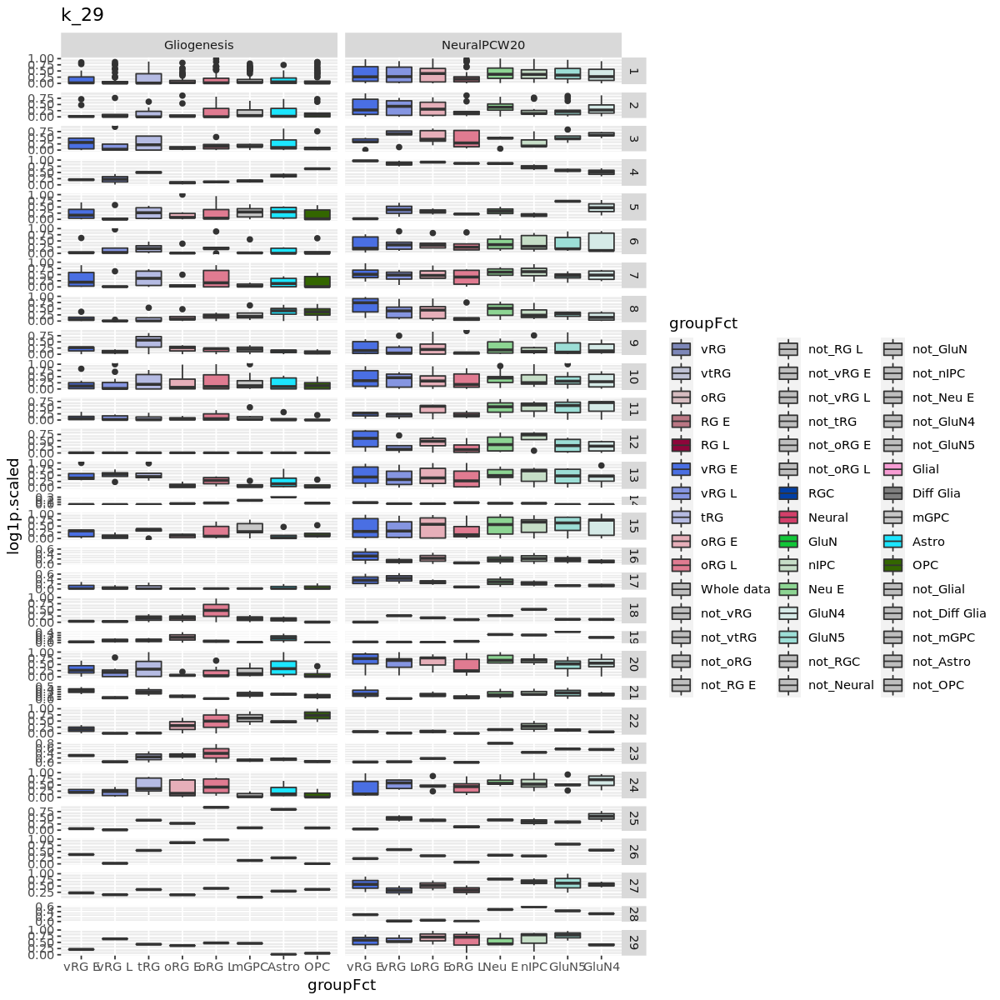

$k_2

$k_3

$k_4

$k_5

$k_6

$k_7

$k_8

$k_9

$k_10

$k_11

$k_12

$k_13

$k_14

$k_15

$k_16

$k_17

$k_18

$k_19

$k_20

$k_21

$k_22

$k_23

$k_24

$k_25

$k_26

$k_27

$k_28

$k_29

$k_30

$gene


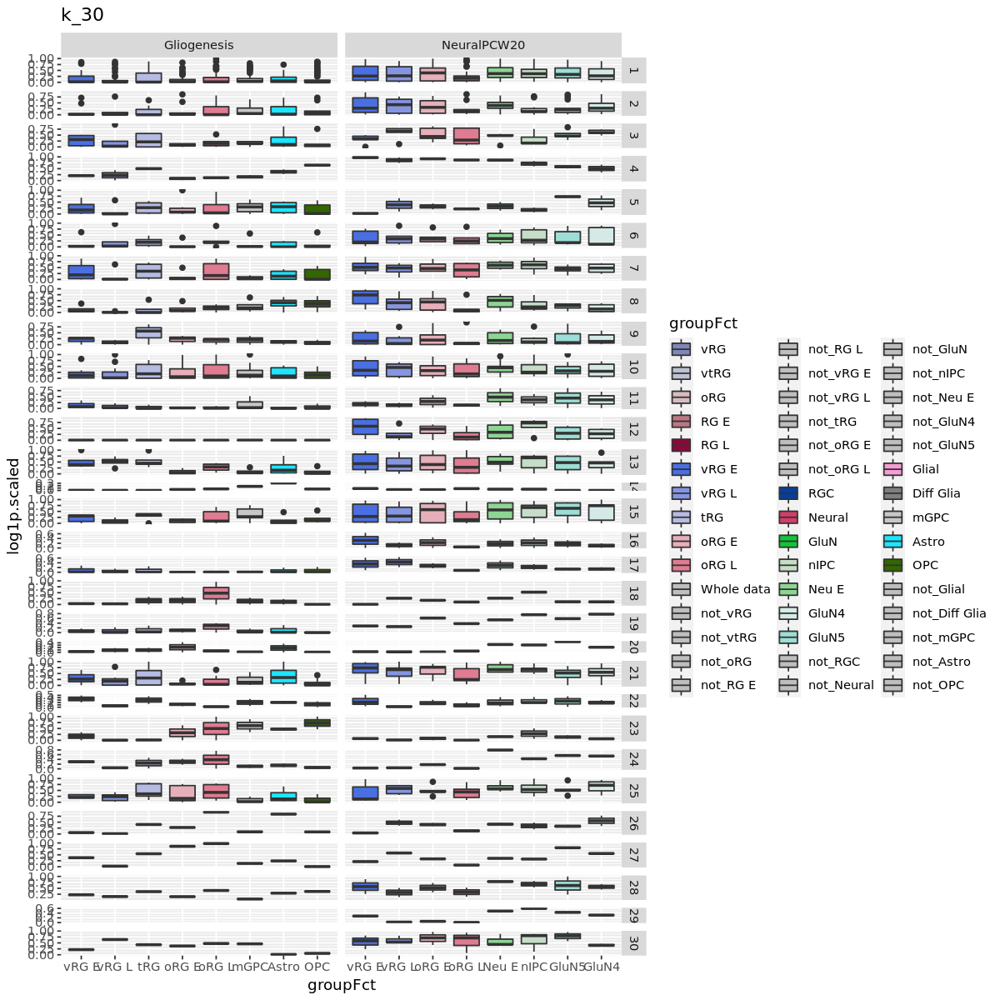

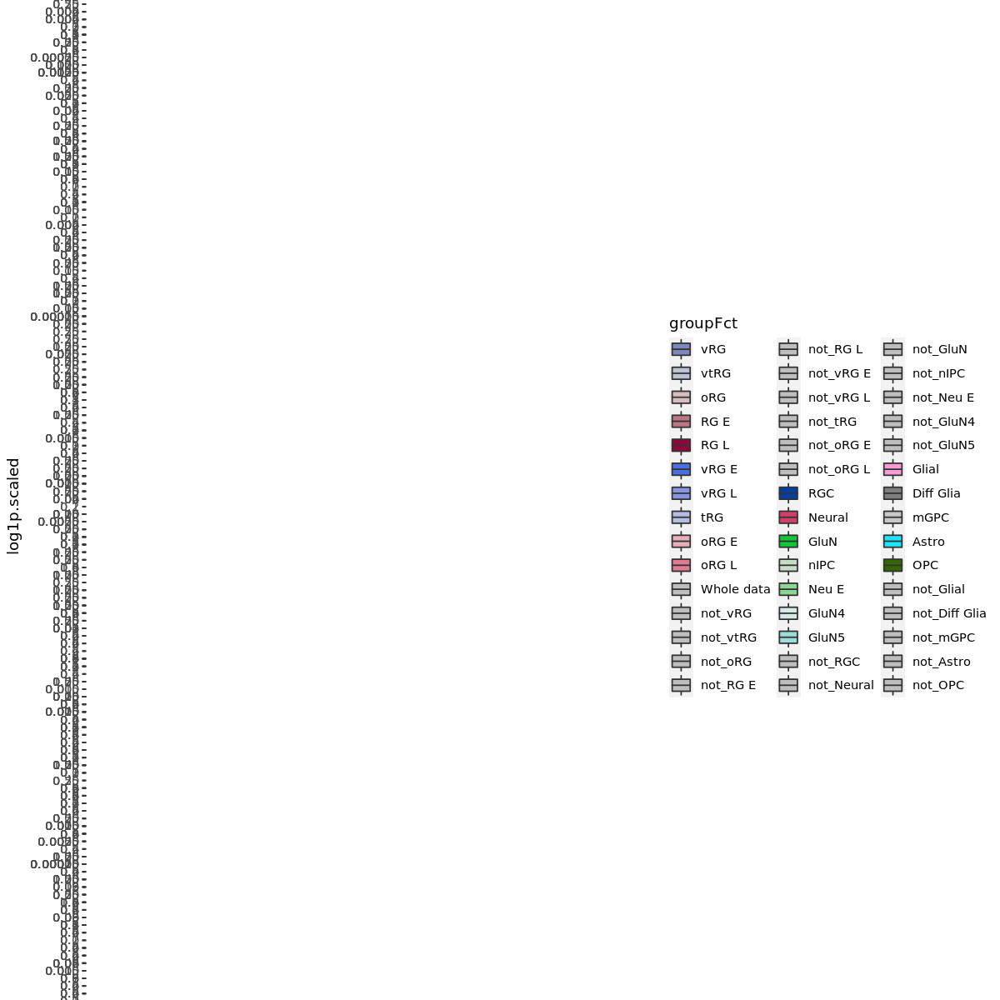

In [37]:
fig(10,10)

ps <- list()
for (col in colnames(gene.clusters)){
    heat.psss$gene.cl <- factor(heat.psss[,col, drop=T])
    p <-  ggplot(
        heat.psss,
        aes(x=groupFct,
            y=log1p.scaled,
            fill=groupFct)) + 
    geom_boxplot() + 
    facet_grid(cols=vars(sampleFct), 
               rows=vars(gene.cl),
               scales='free', space='free') + 
    ggtitle(col) + 
    # scale_color_viridis_c('Perturbation Score\n(scaled per cell type)')
    scale_fill_manual(values=pal)
    
    ps[[col]] <- p
    
}

ps

In [75]:
exps <- data.table::fread('../../../data/NeuralPCW20/perturbations/KO.PerturbationScoreExpression.csv', data.table=F) %>% mutate(gene=V1, V1=NULL) %>% reshape2::melt(id.vars='gene', variable.name='group', value.name='mean.log1p.exp')


pcts <- data.table::fread('../../../data/NeuralPCW20/perturbations/KO.PerturbationScoreExpressionPct.csv', data.table=F) %>% mutate(gene=V1, V1=NULL) %>% reshape2::melt(id.vars='gene', variable.name='group', value.name='pct')


dpdata <- merge(exps, pcts, by=c('gene', 'group'), all=T) %>% mutate(sample='NeuralPCW20')

In [77]:
dpp <- merge(heat.psss, dpdata, all.X=T, all.y=F, by=c('sample', 'group', 'gene'))

In [78]:
dpp

sample,group,gene,score,groupsample,log1p,cell.type,groupFct,sampleFct,log1p.scaled,Control,z.log1p,mean.log1p.exp,pct
<chr>,<chr>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<fct>,<fct>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>
NeuralPCW20,GluN4,ARID3A,4.277998e+00,GluN4 (NeuralPCW20),1.663547e+00,GluN4,GluN4,NeuralPCW20,4.445172e-01,control,0.3115381,0.0816492300,0.106963198
NeuralPCW20,GluN4,ARID5B,8.099563e-01,GluN4 (NeuralPCW20),5.933027e-01,GluN4,GluN4,NeuralPCW20,1.585367e-01,control,-0.7587060,0.0200231280,0.025681758
NeuralPCW20,GluN4,ARX,4.677007e-01,GluN4 (NeuralPCW20),3.836970e-01,GluN4,GluN4,NeuralPCW20,1.025279e-01,control,-0.9683117,0.0132326430,0.017738946
NeuralPCW20,GluN4,ASCL1,4.317911e-01,GluN4 (NeuralPCW20),3.589262e-01,GluN4,GluN4,NeuralPCW20,9.590885e-02,control,-0.9930825,0.1141715500,0.135557321
NeuralPCW20,GluN4,ATF3,2.056568e+01,GluN4 (NeuralPCW20),3.071103e+00,GluN4,GluN4,NeuralPCW20,8.206310e-01,control,1.7190944,0.1186382600,0.145882976
NeuralPCW20,GluN4,BACH2,5.284068e+00,GluN4 (NeuralPCW20),1.838018e+00,GluN4,GluN4,NeuralPCW20,4.911376e-01,control,0.4860088,0.1955647300,0.252846174
NeuralPCW20,GluN4,BBX,1.720894e+01,GluN4 (NeuralPCW20),2.901913e+00,GluN4,GluN4,NeuralPCW20,7.754215e-01,control,1.5499040,0.2398205100,0.265819433
NeuralPCW20,GluN4,BCL11A,3.154836e+01,GluN4 (NeuralPCW20),3.482727e+00,GluN4,GluN4,NeuralPCW20,9.306212e-01,control,2.1307183,1.3652099000,0.893301562
NeuralPCW20,GluN4,BCL11B,3.384553e+00,GluN4 (NeuralPCW20),1.478088e+00,GluN4,GluN4,NeuralPCW20,3.949606e-01,control,0.1260790,0.2223487800,0.246227164


In [421]:
test.dfs <- lapply(split(psss, paste(psss$sample, psss$cell.type)), function(x){
       df <- reshape2::dcast(x, formula = 'gene ~ cell.type+Control', value.var='log1p')
       colnames(df)[2:3] <- sapply(strsplit(colnames(df)[2:3], split='_'), function(x){x[2]})
       df
    })

test.df <- do.call('rbind', lapply(names(test.dfs), function(y){
    # Substraction of ct-normalized values
    a <- apply(apply(test.dfs[[y]][,-1], 2, 
                     function(x){x/max(x,na.rm=T)}), 
               1, function(x){x[2]-x[1]})
    
    ct <- paste(strsplit(y, split=' ')[[1]][-1], collapse=' ')
    s <- strsplit(y, split=' ')[[1]][1]
    data.frame(gene=test.dfs[[y]]$gene, rel_max.diff=a,test=test.dfs[[y]]$test, group=y, sample=s, cell.type=ct)
    }))


# test.df

In [422]:
plot.df <- subset(test.df, cell.type %in%sel.celltypes & sample != 'RGCmaturation')

In [423]:
plot.df$cell.typeLabel <- factor(ifelse(plot.df$cell.type %in% unique(subset(plot.df, sample=='Gliogenesis')$cell.type) & plot.df$sample == 'NeuralPCW20', 'RGC', plot.df$cell.type), CellTypeOrder)
plot.df$cell.typeFct <- factor(plot.df$cell.type, CellTypeOrder)

In [424]:
plot.df <- plot.df %>% group_by(group) %>% mutate(test.rel_max = test/max(test, na.rm=T))

In [426]:
plot.mat <- reshape2::dcast(plot.df, formula = 'gene~sample+cell.typeFct', value.var='rel_max.diff')
plot.mat[is.na(plot.mat)] <- 0
gene.levs <- plot.mat$gene[hclust(dist(plot.mat[,-1]))$order]

In [427]:
library(ggpubr)

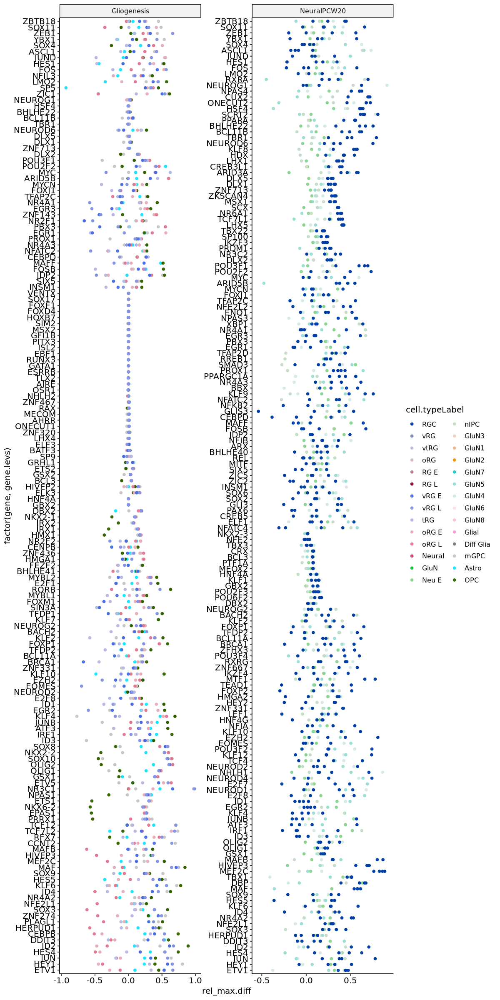

In [428]:
fig(10,20)
ggplot(plot.df, aes(x=rel_max.diff, y=factor(gene, gene.levs), color=cell.typeLabel), alpha=0.5) + geom_point() +
    facet_nested_wrap(vars(sample), scales='free') + 
    # scale_color_manual(values=pal)
    scale_color_manual(values=CellTypeColor) + 
    theme_pubr(base_family = 'ArialMT', legend = 'right')
    # scale_color_viridis_d()


In [429]:
plot.df <- subset(plot.df, cell.typeLabel != 'RGC')

In [430]:
plot.mat2 <- reshape2::dcast(plot.df, formula = 'gene~cell.typeLabel', value.var='rel_max.diff')
plot.mat2[is.na(plot.mat2)] <- 0
gene.levs2 <- plot.mat2$gene[hclust(dist(plot.mat2[,-1]))$order]

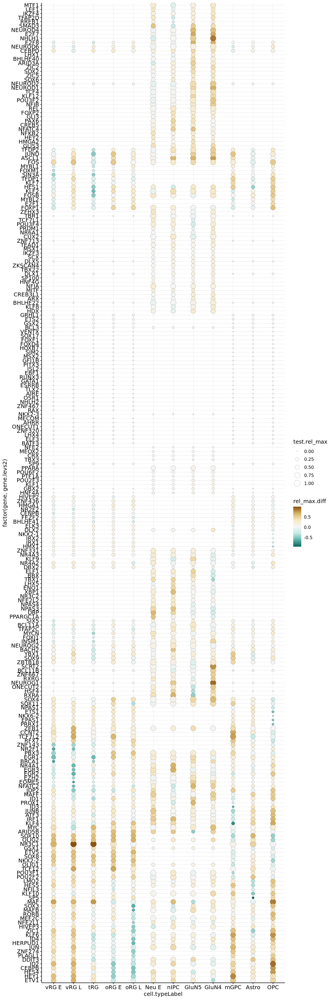

In [452]:
fig(10,30)
ggplot(plot.df, aes(fill=rel_max.diff, y=factor(gene, gene.levs2), 
                    size=test.rel_max, x=cell.typeLabel), alpha=0.5) + 
    geom_point(stroke=0.1, shape=21) +
    # facet_nested_wrap(vars(sample), scales='free') + 
    # scale_color_manual(values=pal)
    # scale_color_manual(values=CellTypeColor) + 
    theme_pubr(base_family = 'ArialMT', legend = 'right')+
    scale_fill_distiller(palette = "BrBG", direction=-1) + 
    scale_size_continuous(limits = c(0,1)) + 
    theme(
        panel.grid.major.x = element_line(size=0.1, color='grey'), panel.grid.major.y = element_line(size=0.1, color='grey')
    )



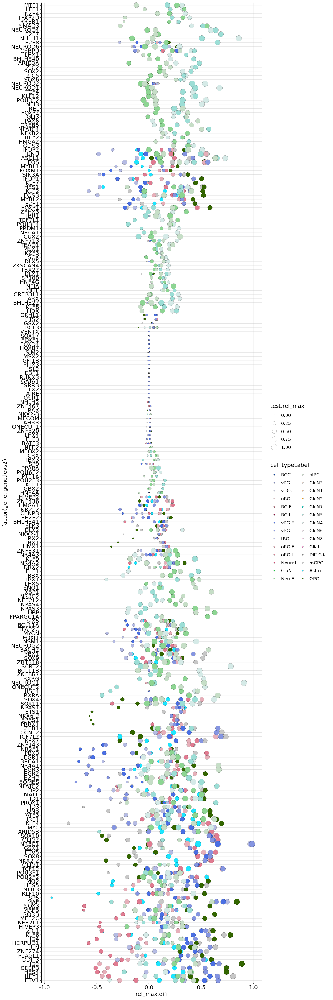

In [460]:
fig(10,30)
ggplot(plot.df, aes(x=rel_max.diff, y=factor(gene, gene.levs2), 
                    size=test.rel_max, fill=cell.typeLabel), alpha=0.5) + 
    geom_point(stroke=0.1, shape=21) +
    # facet_nested_wrap(vars(sample), scales='free') + 
    # scale_color_manual(values=pal)
    scale_fill_manual(values=CellTypeColor) + 
    theme_pubr(base_family = 'ArialMT', legend = 'right')+
    # scale_fill_distiller(palette = "BrBG", direction=-1) + 
    scale_size_continuous(limits = c(0,1)) + 
    theme(
        panel.grid.major.x = element_line(size=0.1, color='grey'), panel.grid.major.y = element_line(size=0.1, color='grey')
    )



In [454]:
top.df <- plot.df
top.df <- subset(top.df, rel_max.diff>0 & test.rel_max>0.5) #%>% group_by(cell.type) %>% slice_max(order_by = test, n = 10)

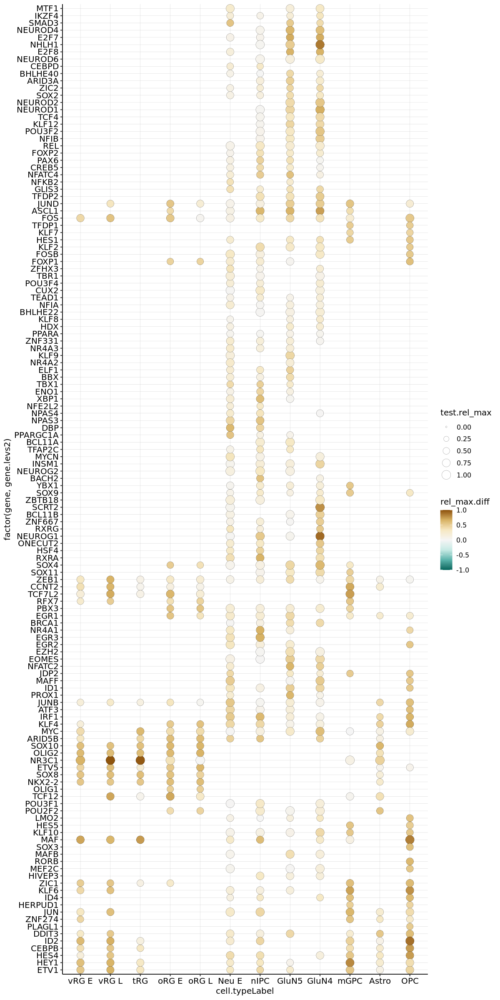

In [457]:
fig(10,20)
ggplot(top.df, aes(fill=rel_max.diff, y=factor(gene, gene.levs2), 
                    size=test.rel_max, x=cell.typeLabel), alpha=0.5) + 
    geom_point(stroke=0.1, shape=21) +
    # facet_nested_wrap(vars(sample), scales='free') + 
    # scale_color_manual(values=pal)
    # scale_color_manual(values=CellTypeColor) + 
    theme_pubr(base_family = 'ArialMT', legend = 'right')+
    scale_fill_distiller(palette = "BrBG", direction=-1, limits = c(-1,1)) + 
    scale_size_continuous(limits = c(0,1)) + 
    theme(
        panel.grid.major.x = element_line(size=0.1, color='grey'), panel.grid.major.y = element_line(size=0.1, color='grey')
    )



In [281]:
corres  <- cor.test(x =  test.dfs$Astro$test, y =  test.dfs$Astro$control)
corres$


	Pearson's product-moment correlation

data:  test.dfs$Astro$test and test.dfs$Astro$control
t = 9.3087, df = 156, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.4868675 0.6893953
sample estimates:
    cor 
0.59758 


In [262]:
w <- wilcox.test(test.dfs[[1]]$test, test.dfs[[1]]$control, paired = T)

## Heatmap explore

In [202]:
head(psss)

group,score,gene,sample,groupsample,log1p,cell.type,groupFct,sampleFct,log1p.scaled
<chr>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<chr>,<fct>,<fct>,<dbl>
vRG,1.339978e-04,AIRE,RGCmaturation,vRG (RGCmaturation),1.339888e-04,vRG,vRG,RGCmaturation,0.0004696602
vtRG,1.340006e-04,AIRE,RGCmaturation,vtRG (RGCmaturation),1.339916e-04,vtRG,vtRG,RGCmaturation,0.0003774217
oRG,3.686897e-03,AIRE,RGCmaturation,oRG (RGCmaturation),3.680117e-03,oRG,oRG,RGCmaturation,0.0063076165
RG E,8.461723e-05,AIRE,RGCmaturation,RG E (RGCmaturation),8.461365e-05,RG E,RG E,RGCmaturation,0.0003423314
RG L,1.339978e-04,AIRE,RGCmaturation,RG L (RGCmaturation),1.339888e-04,RG L,RG L,RGCmaturation,0.0004696602
vRG E,8.461723e-05,AIRE,RGCmaturation,vRG E (RGCmaturation),8.461365e-05,vRG E,vRG E,RGCmaturation,0.0003423314


In [203]:
library(ggh4x)

In [1]:
fig(20,20)
ggplot(plot.df,
    aes(x=groupFct, y=gene, fill=log1p.scaled)) +
    geom_tile() +
    scale_fill_continuous(na.value='grey') +
    facet_nested(cols=vars(cell.type, sample), scales='free', space='free')

ERROR: Error in fig(20, 20): could not find function "fig"


## Histograms for exploration

In [69]:
unique(psss$group)

[1] "vRG"           "vtRG"          "oRG"           "RG E"         
 [5] "RG L"          "vRG E"         "vRG L"         "tRG"          
 [9] "oRG E"         "oRG L"         "Whole data"    "not_vRG"      
[13] "not_vtRG"      "not_oRG"       "not_RG E"      "not_RG L"     
[17] "not_vRG E"     "not_vRG L"     "not_tRG"       "not_oRG E"    
[21] "not_oRG L"     "RGC"           "Neural"        "GluN"         
[25] "nIPC"          "Neu E"         "GluN4"         "GluN5"        
[29] "not_RGC"       "not_Neural"    "not_GluN"      "not_nIPC"     
[33] "not_Neu E"     "not_GluN4"     "not_GluN5"     "Glial"        
[37] "Diff Glia"     "mGPC"          "Astro"         "OPC"          
[41] "not_Glial"     "not_Diff Glia" "not_mGPC"      "not_Astro"    
[45] "not_OPC"

In [77]:
length(groups)

[1] 45

Warning message:
“Removed 1 rows containing non-finite values (stat_density).”


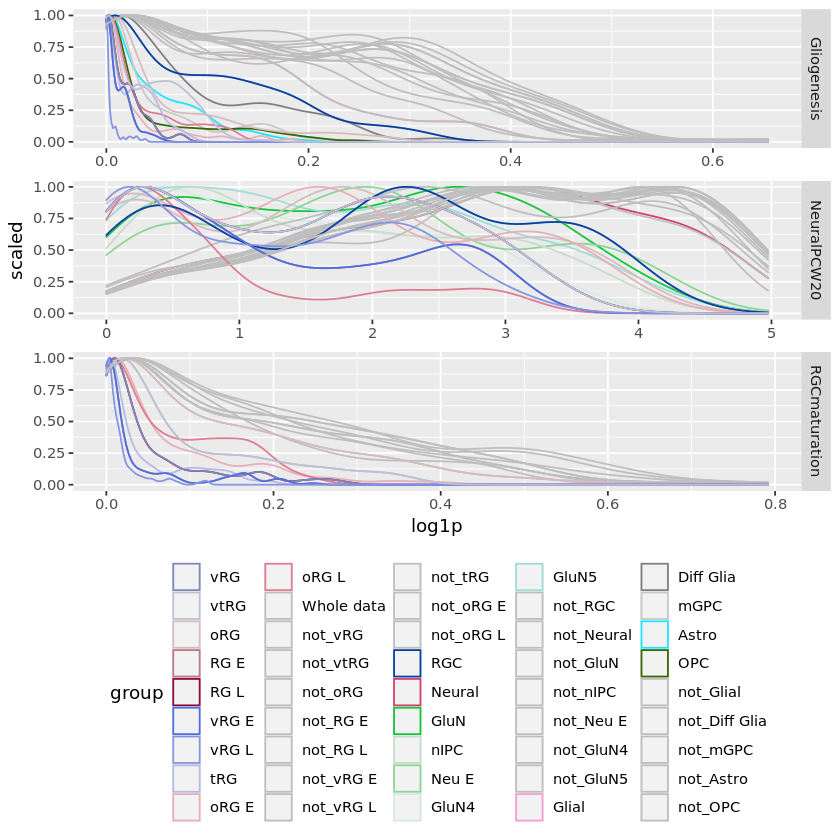

In [80]:
ggplot(psss, aes(x=log1p, color=group)) + 
    geom_density(aes(y=..scaled..)) +
    facet_grid2(rows=vars(sample), scales='free', independent='x') + 
    theme(legend.position='bottom') +
    scale_color_manual(values=pal)
    

Warning message:
“Removed 1 rows containing non-finite values (stat_ydensity).”


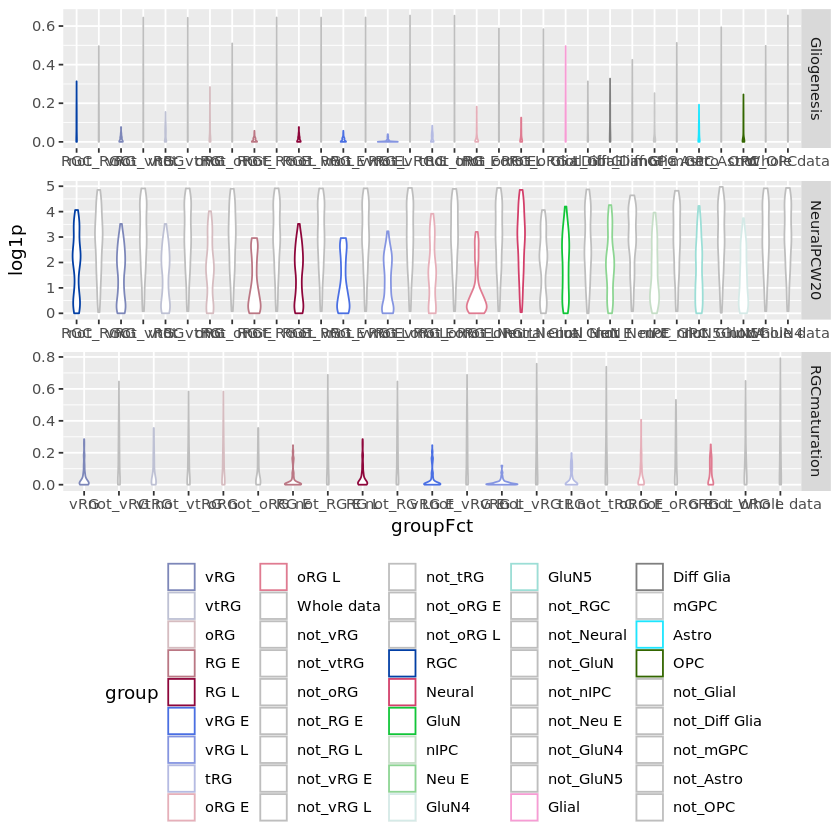

In [85]:
ggplot(psss, aes(x = groupFct, y=log1p, color=group)) + 
    geom_violin() +
    facet_grid2(rows=vars(sample), scales='free', independent='x') + 
    theme(legend.position='bottom') +
    scale_color_manual(values=pal)
    

In [122]:
ps <- subset(psss, sample == 'NeuralPCW20' & group %in%c('RGC', 'not_RGC'))



In [120]:
ps.mat <- reshape2::dcast(ps, formula = 'gene ~ group', value.var='log1p.scaled')

gene.levs <- ps.mat$gene[hclust(dist(ps.mat))$order]

In [137]:
genes.labels <- ps.mat$gene[ps.mat$not_RGC < ps.mat$RGC]

In [131]:
gene.levs <- (subset(ps, group == 'RGC') %>% arrange(desc(log1p)) )$gene

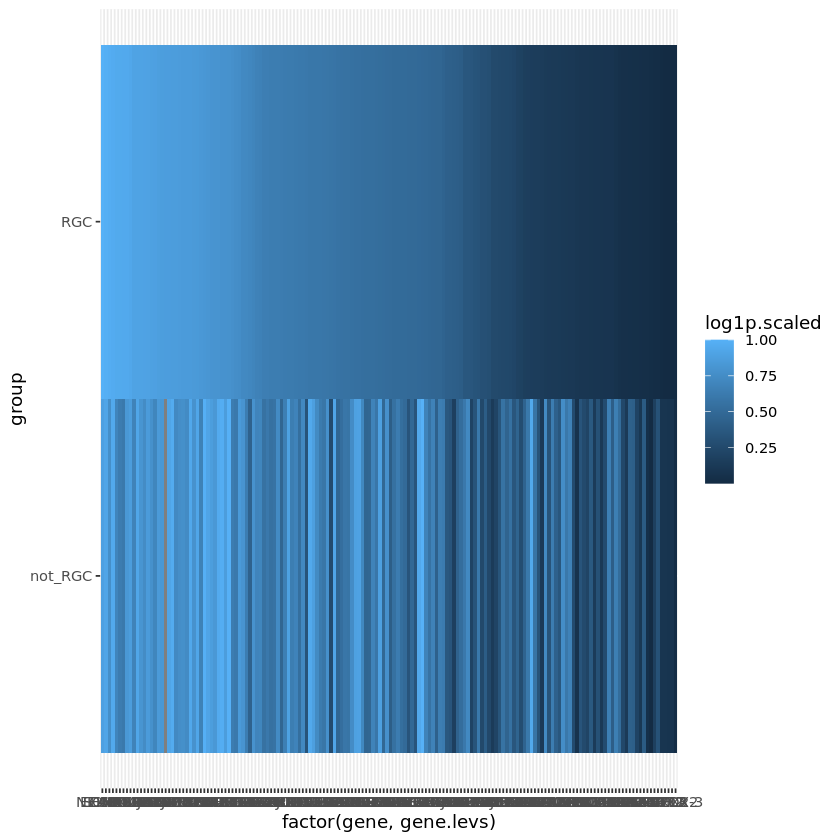

In [132]:
ggplot(ps, aes(x=factor(gene, gene.levs), y=group, fill=log1p.scaled)) + geom_tile()

In [134]:
library(ggrepel)

Warning message:
“Removed 58 rows containing missing values (geom_text_repel).”
Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


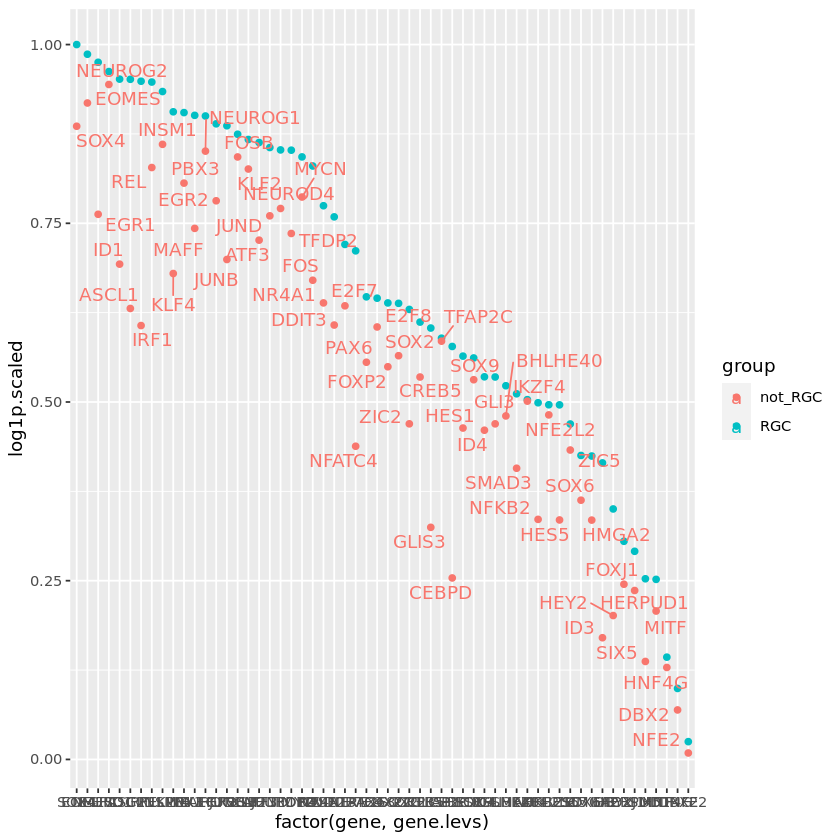

In [142]:
ggplot(subset(ps, gene%in%genes.labels), aes(x=factor(gene, gene.levs), color=group, y=log1p.scaled)) + geom_point() + geom_text_repel(aes(label = ifelse(
    gene %in% genes.labels & group != 'RGC', gene, NA
)))

## Volcano

In [24]:
volc.psss <- subset(psss, cell.type != 'Whole data')

In [29]:
volc.psss <- merge(
    subset(volc.psss, Control == 'control'), 
    subset(volc.psss, Control != 'control'), 
    by=c('gene', 'cell.type', 'sample'), 
    suffixes = c('.control', '.test'))

In [34]:
library(ggh4x)

Warning message:
“Removed 1 rows containing missing values (geom_point).”


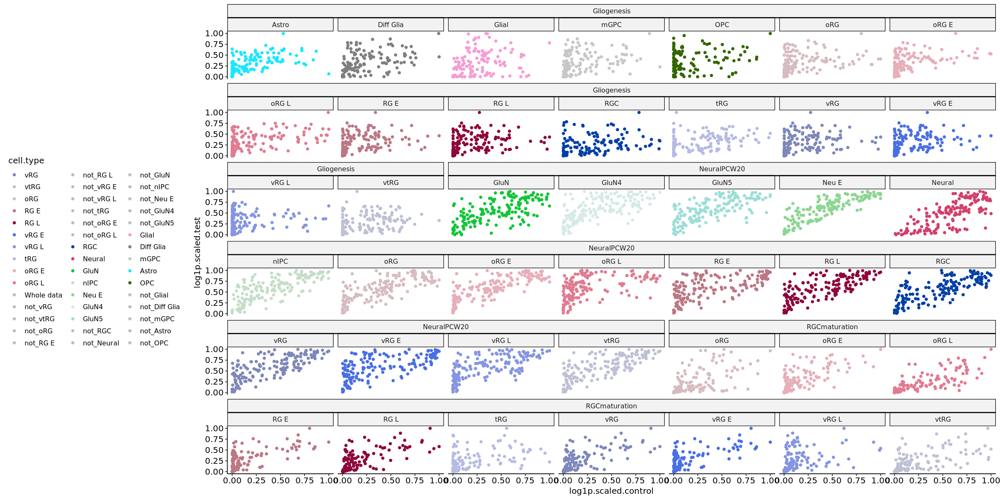

In [39]:
fig(20,10)
ggplot(volc.psss, aes(x=log1p.scaled.control, y=log1p.scaled.test, color=cell.type)) + 
geom_point() + facet_nested_wrap(vars(sample, cell.type)) + scale_color_manual(values=pal) + theme_pubr(legend = 'left')

In [30]:
volc.psss

gene,cell.type,sample,group.control,score.control,groupsample.control,log1p.control,groupFct.control,sampleFct.control,log1p.scaled.control,Control.control,group.test,score.test,groupsample.test,log1p.test,groupFct.test,sampleFct.test,log1p.scaled.test,Control.test
<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<dbl>,<fct>,<fct>,<dbl>,<chr>,<chr>,<dbl>,<chr>,<dbl>,<fct>,<fct>,<dbl>,<chr>
AHRR,Astro,Gliogenesis,Astro,6.294757e-06,Astro (Gliogenesis),6.294738e-06,Astro,Gliogenesis,3.272288e-05,control,not_Astro,0.0057648432,not_Astro (Gliogenesis),0.0057482901,not_Astro,Gliogenesis,0.0096882757,test
AHRR,Diff Glia,Gliogenesis,Diff Glia,7.029716e-06,Diff Glia (Gliogenesis),7.029691e-06,Diff Glia,Gliogenesis,2.146569e-05,control,not_Diff Glia,0.0057955447,not_Diff Glia (Gliogenesis),0.0057788152,not_Diff Glia,Gliogenesis,0.0135983882,test
AHRR,Glial,Gliogenesis,Glial,4.800558e-03,Glial (Gliogenesis),4.789072e-03,Glial,Gliogenesis,9.657887e-03,control,not_Glial,0.0009017350,not_Glial (Gliogenesis),0.0009013286,not_Glial,Gliogenesis,0.0028752998,test
AHRR,mGPC,Gliogenesis,mGPC,4.888043e-03,mGPC (Gliogenesis),4.876135e-03,mGPC,Gliogenesis,1.931570e-02,control,not_mGPC,0.0009083817,not_mGPC (Gliogenesis),0.0009079694,not_mGPC,Gliogenesis,0.0017712017,test
AHRR,OPC,Gliogenesis,OPC,7.349585e-07,OPC (Gliogenesis),7.349582e-07,OPC,Gliogenesis,2.993754e-06,control,not_OPC,0.0057387956,not_OPC (Gliogenesis),0.0057223915,not_OPC,Gliogenesis,0.0115090139,test
AHRR,oRG,Gliogenesis,oRG,6.620771e-04,oRG (Gliogenesis),6.618580e-04,oRG,Gliogenesis,2.329864e-03,control,not_oRG,0.0050472387,not_oRG (Gliogenesis),0.0050345441,not_oRG,Gliogenesis,0.0098711967,test
AHRR,oRG E,Gliogenesis,oRG E,5.227614e-04,oRG E (Gliogenesis),5.226248e-04,oRG E,Gliogenesis,2.865643e-03,control,not_oRG E,0.0051699316,not_oRG E (Gliogenesis),0.0051566134,not_oRG E,Gliogenesis,0.0087768469,test
AHRR,oRG L,Gliogenesis,oRG L,1.236038e-04,oRG L (Gliogenesis),1.235962e-04,oRG L,Gliogenesis,9.833107e-04,control,not_oRG L,0.0055689247,not_oRG L (Gliogenesis),0.0055534756,not_oRG L,Gliogenesis,0.0095129919,test
AHRR,RG E,Gliogenesis,RG E,1.766515e-04,RG E (Gliogenesis),1.766359e-04,RG E,Gliogenesis,3.083077e-03,control,not_RG E,0.0055547748,not_RG E (Gliogenesis),0.0055394039,not_RG E,Gliogenesis,0.0085985306,test


In [20]:
pss.df <- merge(
    pss_per_group[['RGC']], 
    pss_per_group[['GluN']],
    by = 'gene',
    all = T, 
    suffixes = c('.g1', '.g2')
)
pss.df$do.label <- apply(pss.df[, c('over.20pct.g1','over.20pct.g2')], 1, sum) == 1

pss.df$color <- apply(pss.df[, c('over.20pct.g1','over.20pct.g2')], 1, function(x){
    if (x['over.20pct.g1'] & x['over.20pct.g2']) {'grey'}
    else if (x['over.20pct.g1']) {'red'}
    else if (x['over.20pct.g2']) {'blue'}
    else {'grey'}
})

In [13]:
plot_pss_comp(pss.df, 'RGC','GluN')

ERROR: Error in plot_pss_comp(pss.df, "RGC", "Neural"): could not find function "plot_pss_comp"


In [21]:
p <- ggplot(
    pss.df, 
    aes(x=log1p.g1, y=log1p.g2, 
        label=ifelse(do.label, gene, NA),
        # color=do.label,
        color=color,
        # size= log1p.g1,
        # color=log1p.g2
       )) + 
    ggtitle('RGC vs GluN') + 
    scale_color_identity() + 
    geom_point() +
    geom_text_repel(size=4, max.overlaps=20) +
    theme_pubr() + labs_pubr() +
    labs(x='RGC', y='Neural') + 
    theme(text=element_text(family='ArialMT'))

Warning message:
“Removed 127 rows containing missing values (geom_text_repel).”


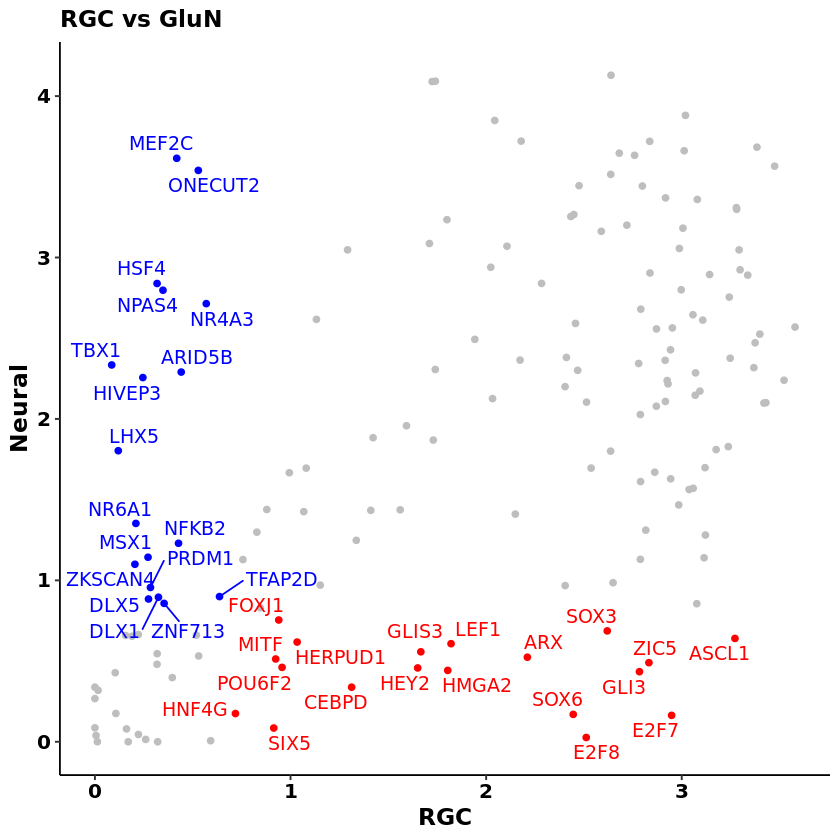

In [23]:
fig(7,7)
p

In [471]:
p <- ggplot(
    pss.df, 
    aes(x=log1p.g1, y=log1p.g2, 
        label=ifelse(do.label, gene, NA),
        # color=do.label,
        color=color,
        # size= log1p.g1,
        # color=log1p.g2
       )) + 
    ggtitle('RGC vs GluN') + 
    scale_color_identity() + 
    geom_point() +
    geom_text_repel(size=4, max.overlaps=20) +
    theme_pubr() + labs_pubr() +
    labs(x='RGC', y='Neural') + 
    theme(text=element_text(family='ArialMT'))

Warning message:
“Removed 108 rows containing missing values (geom_text_repel).”
Warning message:
“ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


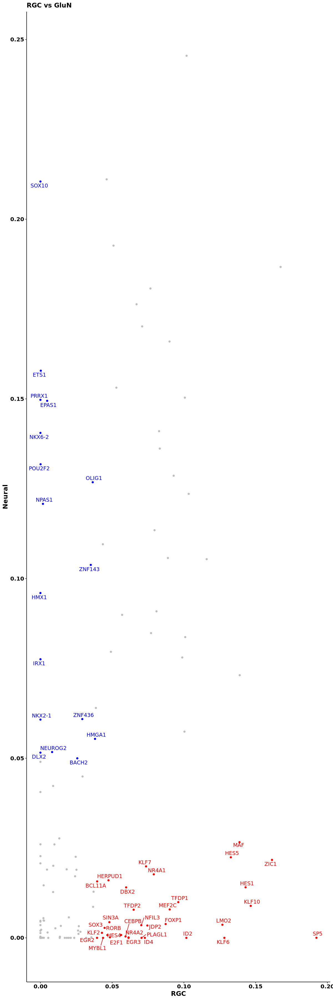

In [472]:
p

### RGC vs Glial

In [52]:
pss <- subset(psss, group %in% c('RGC', 'Glial'))
pss <- lapply(split(pss, pss$group), function(x){
    max.score <- max(x$log1p)
    req.score <- max.score/5
    x$over.20pct <- x$log1p > req.score
    x
})

In [56]:
pss <- merge(
    pss$RGC, 
    pss$Glial,
    by = 'gene',
    all = T, 
    suffixes = c('.RGC', '.Glial')
)

pss$do.label <- apply(pss[, grep('over.20', colnames(pss), fixed=T)], 1, sum) == 1

In [59]:
library(ggplot2)
library(ggrepel)

Warning message:
“Removed 113 rows containing missing values (geom_text_repel).”


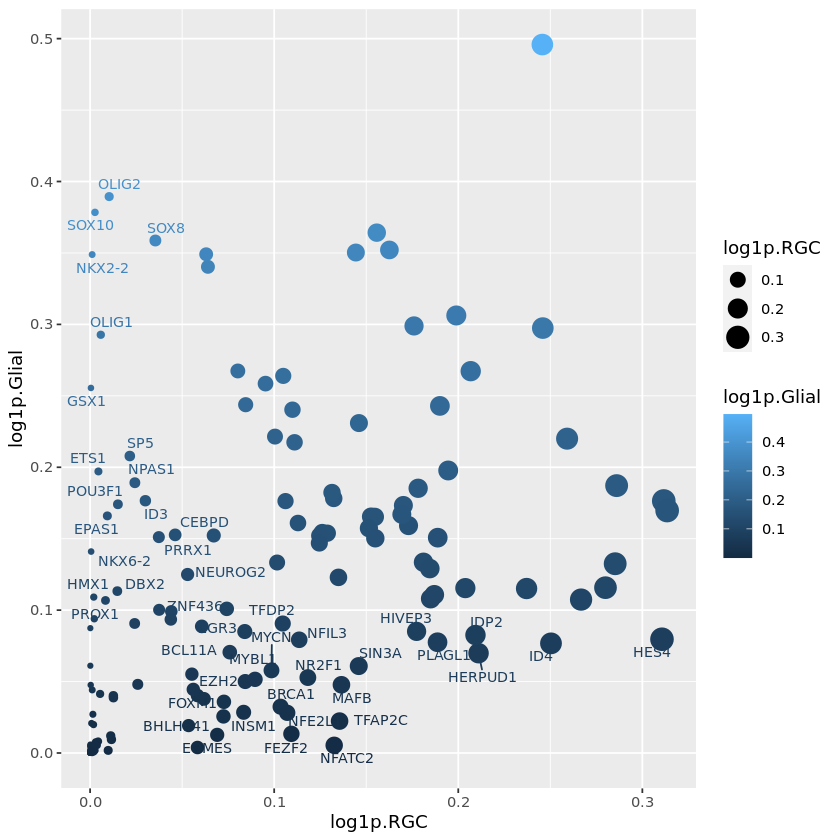

In [65]:
ggplot(
    pss, aes(x=log1p.RGC, y=log1p.Glial, size= log1p.RGC, color=log1p.Glial)) + 
    geom_point() +
    geom_text_repel(
        aes(label=ifelse(do.label, gene, NA)), size=3
    )

https://pathway-viewer.toolforge.org/embed/WP4304

## Cluster perturbation  
Important to match formula to expected axes in plots

In [3]:
cluster_genes <- function(df, score){
    
    df$Gene <- as.character(df$Gene)
    cluster.ct.df <- reshape2::dcast(
        df,
        'Gene ~ cell.type',
        value.var = score)

    cluster.ct.df <- data.frame(cluster.ct.df[,-1], row.names = cluster.ct.df[,1])
    cluster.ct.df[is.na(cluster.ct.df)] <- 0
    cluster.ct.hc <- hclust(dist(cluster.ct.df, 
                              method = 'euclidean'), 
                         method = 'ward.D2')
    cluster.ct.genes <- cluster.ct.hc[['labels']][cluster.ct.hc[['order']]]
    return(cluster.ct.genes)
}

## Heatmap perturbation

In [4]:
library(viridis)

Loading required package: viridisLite



In [5]:
do.heatscore <- function(df, sorted_genes){

    p <- ggplot(df, aes(x=cell.type, y=factor(Gene, levels=rev(sorted_genes)), fill=plot.score)) +
      geom_tile(color='grey', linewidth=0.1) + 
      scale_fill_viridis_c(name=ScoreLabels[score], 'rocket', direction = -1) + 

      ylab('Gene') +
      xlab('Cell type') +
      ggtitle(SampleLabels[sample], subtitle=paste(sample, ScoreLabels[score])) +

      theme_pubr(legend = 'bottom') +
      labs_pubr(base_family = 'ArialMT') +
      guides(fill = guide_colorbar(barwidtht = 1)) +

      theme(
        panel.spacing = unit(0.2, "lines"),
        # strip.background = element_blank(),
        # strip.placement = 'outside',
        panel.background = element_blank(),
        axis.text.x = element_text(angle = 90, hjust=1, vjust=0.5),
        axis.text.y = element_text(),
        # legend.box="vertical",
        legend.text = element_text(angle=90, hjust=1, vjust=0.5))
    return(p)
}

# Option 1: Heatmap and confusions

In [6]:
library(doParallel)

Loading required package: foreach

Loading required package: iterators

Loading required package: parallel



In [ ]:
for (sample in unique(NetworkScores$Sample)){
    
    sample.df <- subset(NetworkScores, Sample == sample)
    sample.genes <- unique(sample.df$Gene)    
    
    cl <- parallel::makeForkCluster(length(ScoreInclude))
    doParallel::registerDoParallel(cl)
     
    wait_res <- foreach(score = ScoreInclude, 
                        .verbose = T ) %dopar% {
    # for (score in ScoreInclude){
    
        for (scale.score in c(FALSE)){ # we do not want scaling
            
            for (recluster in c(TRUE, FALSE)){

                for (gene.subset in c('Cores', 'Regulons')){#, 'all')){
                    
                    
                    label <- paste(sample, score, sep = '.')
                    
                    plot.df <- sample.df
                    plot.df$plot.score <- plot.df[,score, drop=T]
                    sorted_genes <- sample.genes

                    if (gene.subset=='Cores'){
                        sorted_genes <- sorted_genes[sorted_genes%in%regulon_cores]
                        plot.df <- subset(plot.df, Gene %in% regulon_cores)
                        label <- paste(label, gene.subset, sep = '.')
                        
                    } else if (gene.subset=='Regulons'){
                        sorted_genes <- sorted_genes[sorted_genes%in%regulon_genes]
                        plot.df <- subset(plot.df, Gene %in% regulon_genes)
                        label <- paste(label, gene.subset, sep = '.')
                    }

                    if (scale.score){
                        plot.df <- plot.df %>% group_by(Gene) %>% 
                                       mutate(plot.score=scales::rescale(x = plot.score, to = c(0,1)))
                        label <- paste(label, 'Scaled', sep = '.')
                    }

                    if (recluster){
                        sorted_genes <- cluster_genes(plot.df, score = score)
                    } else {
                        sorted_genes <- gene.peak.order[gene.peak.order%in%sorted_genes]
                        plot.df <- subset(plot.df, Gene %in% sorted_genes)
                        label <- paste(label, 'PeakSorted', sep = '.')
                    }

                    print(label)
                    n.cts <- length(unique(plot.df$cell.type))
                    n.gs <- length(unique(plot.df$Gene))
                    print(paste('# CT', n.cts, '| # genes', n.gs))

                    
                    htmp <- do.heatscore(plot.df, sorted_genes = sorted_genes)

                    pdf(file=paste0('HeatmapScore.', label, '.pdf'), 
                        width=n.cts*0.15+6, 
                        height=n.gs*0.16+3.4)#max(10, n.gs/10)) ## change this for an actual formula :) 
                    plot(htmp)
                    dev.off()



                    dis.conf.plot <- do.conf.dis.plot(genes=sorted_genes)
                    peak.conf.plot <- do.conf.peak.plot(genes=sorted_genes)

                    comb.plot <- cowplot::plot_grid(
                        htmp, 
                        peak.conf.plot + theme(axis.text.y=element_blank(),axis.title.y=element_blank()), 
                        dis.conf.plot+ theme(axis.text.y=element_blank(),axis.title.y=element_blank()),

                        nrow=1, align='h', axis='tb', 

                        rel_widths=c(1,1,1))

                    pdf(file=paste0('HeatmapScore.', label, '.Combined.pdf'), 
                        width=n.cts*0.15+9, 
                        height=n.gs*0.16+3.4)#max(10, n.gs/10)) ## change this for an actual formula :) 
                    plot(comb.plot)
                    dev.off()
                    
                }
            }
        }        
    }
    parallel::stopCluster(cl)

}

# Option 2: cell type comparison per disease

In [4]:
get.expand.dis.df <- function(df){
    
    dis.genes <- subset(get.conf.dis.df(unique(df$Gene)), Value!='None')
    dis.list <- split(dis.genes[,c('Gene', 'Value')], dis.genes$Disease)

    dis.df <- do.call('rbind', 
                      lapply(
                          names(dis.list),
                          function(x){

                              dgenes <- unique(dis.list[[x]]$Gene)
                              ddf <- subset(df, Gene %in% dgenes)

                              ddf$Disease <- x
                              ddf$Value <- dis.list[[x]]$Value[match(x=ddf$Gene, dis.list[[x]]$Gene)]
                              ddf

                          })) %>% mutate(Disease=factor(Disease, names(dis.list)))
    return(dis.df)
}


In [12]:
network.dis.df <- get.expand.dis.df(subset(NetworkScores, Sample %in% SampleInclude))

In [13]:
# network.dis.df$cell.type.label <- factor(CellTypeLabels[as.character(network.dis.df$cell.type)], CellTypeOrder)
network.dis.df$cell.type.label <- factor(as.character(network.dis.df$cell.type), CellTypeOrder)

In [14]:
network.dis.df$is.core <- network.dis.df$Gene %in% regulon_cores

## Boxplot

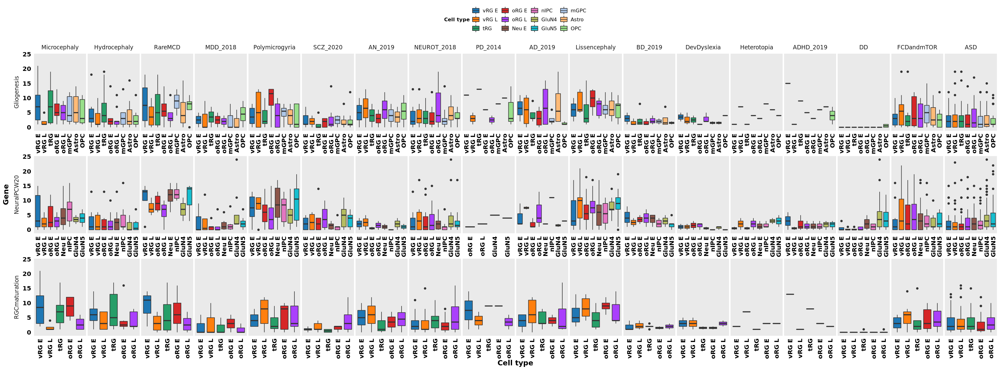

In [15]:
fig(27,10)
p <- ggplot(network.dis.df, 
            aes(x=cell.type.label, 
                y=degree_in,
                # color=Value
                fill=cell.type.label
               )) +
    facet_grid2(cols=vars(Disease), rows=vars(Sample), scales='free_x', independent = 'x', switch='y') +

    # geom_point(
    #     alpha=0.8,
    #     position=position_jitter(height=0)
    # ) + 

    geom_boxplot(
    ) + 
    scale_fill_manual('Cell type', values = CellTypeColor) +
  # scale_fill_viridis_c(name=ScoreLabels[score], 'rocket', direction = -1) + 

  ylab('Gene') +
  xlab('Cell type') +
  # ggtitle(SampleLabels[sample], subtitle=paste(sample, ScoreLabels[score])) +

  theme_pubr(legend = 'top') +
  labs_pubr(base_family = 'ArialMT') +
  # guides(fill = guide_colorbar(barwidtht = 1)) +

  theme(
    panel.spacing = unit(0.2, "lines"),
    strip.background = element_blank(),
    strip.placement = 'outside',
    panel.background  = element_rect(fill='#eaeaea'),element_blank(),
    axis.text.x = element_text(angle = 90, hjust=1, vjust=0.5),
    axis.text.y = element_text(),
    # legend.box="vertical",
    # legend.text = element_text(angle=90, hjust=1, vjust=0.5)
  )
p


## Violin

Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”
Warning message:
“Groups with fewer than two data points have been dropped.”

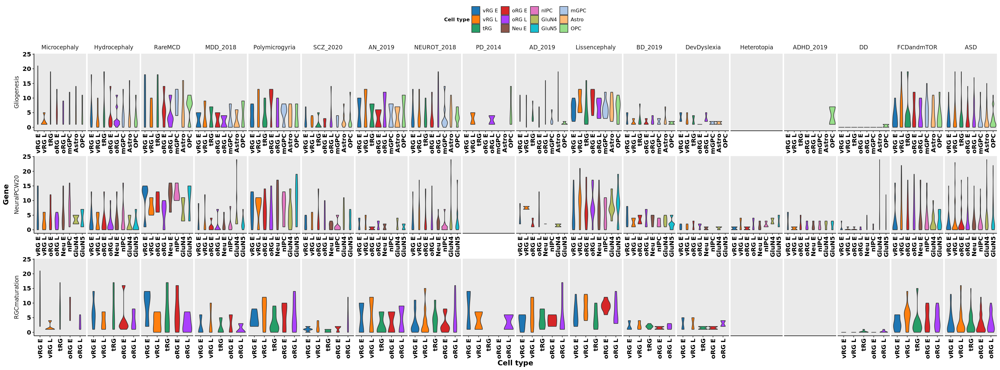

In [17]:
fig(27,10)
p <- ggplot(network.dis.df, 
            aes(x=cell.type.label, 
                y=degree_in,
                # color=Value
                fill=cell.type.label
               )) +
    facet_grid2(cols=vars(Disease), rows=vars(Sample), scales='free_x', independent = 'x', switch='y') +

    # geom_point(
    #     alpha=0.8,
    #     position=position_jitter(height=0)
    # ) + 

    geom_violin(
    ) + 
    scale_fill_manual('Cell type', values = CellTypeColor) +
  # scale_fill_viridis_c(name=ScoreLabels[score], 'rocket', direction = -1) + 

  ylab('Gene') +
  xlab('Cell type') +
  # ggtitle(SampleLabels[sample], subtitle=paste(sample, ScoreLabels[score])) +

  theme_pubr(legend = 'top') +
  labs_pubr(base_family = 'ArialMT') +
  # guides(fill = guide_colorbar(barwidtht = 1)) +

  theme(panel.background  = element_rect(fill='#eaeaea'),
    panel.spacing = unit(0.2, "lines"),
    strip.background = element_blank(),
    strip.placement = 'outside',
    # panel.background = element_blank(),
    axis.text.x = element_text(angle = 90, hjust=1, vjust=0.5),
    axis.text.y = element_text(),
    # legend.box="vertical",
    # legend.text = element_text(angle=90, hjust=1, vjust=0.5)
  )
p


## Manhattan Per Cell Type

In [18]:
library(ggrepel)

In [20]:
fname <- 'ScoreComparison.PerDisease.pdf'
pdf(fname, width=20, height=9, useDingbats = F)

for (score in ScoreInclude){
    message(score)
    network.dis.df$score.plot <- network.dis.df[,score, drop=T]
    
    
    p <- ggplot(network.dis.df, 
                aes(#x=0,
                    x=cell.type.label,
                    y=score.plot,
                    # color=Value
                    color=cell.type.label
                   )) +
        facet_grid2(cols=vars(Disease), rows=vars(SampleLabel), scales='free_x', independent = 'x', switch='y') +

        geom_point(
            aes(shape=is.core),
            size=2, stroke=1,
            fill='transparent',
            alpha=0.8,
            # position=pos_jit_width
        ) + 
        scale_shape_manual('Regulon core TF', values=c('TRUE'=19, 'FALSE'=21), labels=c('TRUE'='Yes', 'FALSE'='No')) +
        scale_color_manual('Cell type', values = CellTypeColor) +

      ylab(ScoreLabels[score]) +
      xlab('Cell type') +
      # ggtitle(SampleLabels[sample], subtitle=paste(sample, ScoreLabels[score])) +

      theme_pubr(legend = 'bottom') +
      labs_pubr(base_family = 'ArialMT') +
      # guides(fill = guide_colorbar(barwidtht = 1)) +

      theme(
          text = element_text(family='ArialMT'),
        panel.border = element_rect(colour = "darkgrey", fill=NA, 
                                    # linewidth=0.8,
                                    size=0.8
                                   ),
        panel.grid.major.y = element_line(color='grey', 
                                          # linewidth=0.5
                                          size=0.5
                                         ),
        panel.grid.minor.y = element_line(color='grey', 
                                          # linewidth=0.5
                                          size=0.5
                                         ),
        panel.spacing = unit(0.2, "lines"),
        strip.background = element_blank(),
        strip.placement = 'outside',
        panel.background  = element_rect(fill='white'),
        # axis.text.x = element_blank(),
        # axis.ticks.x = element_blank(),
        axis.text.x = element_text(angle = 90, hjust=1, vjust=0.5),
        axis.text.y = element_text(),

        # legend.box="vertical",
        # legend.text = element_text(angle=90, hjust=1, vjust=0.5)
      )



    to_annot <- network.dis.df %>% group_by(Disease, Sample) %>% 
        slice_max(order_by = score.plot, n = 5, with_ties = FALSE)
    nrow(to_annot)

    p <- p + geom_text_repel(data = to_annot,
                             mapping = aes(label=Gene), 
                         size=3, color='black',
                         # position = pos_jit_width, 
                         min.segment.length = 0)


    plot(p)
} 
dev.off()

degree_all

degree_centrality_all

degree_in

degree_centrality_in

degree_out

degree_centrality_out

betweenness_centrality

eigenvector_centrality

connectivity

participation



png 
  2

## Manhattan Per Gene

In [21]:
order_df <- function(df, grouped, label.genes = 5, only.top.n = 25){

    
    gene.maxs <- df %>% 
        group_by(Gene) %>% 
        summarise(max.score = max(score.plot), 
                  which.max.score=as.character(cell.type)[which.max(score.plot)[1]]) %>% ungroup() %>%
        arrange(desc(max.score)) %>% mutate(gene.order = order(max.score, decreasing = T, na.last = T))
    
    gene.maxs$is.top.gene <- gene.maxs$gene.order <= label.genes
    
    
    df <- merge(df, gene.maxs, by='Gene', all=T)
    df$label <- ifelse(
        (
            (as.character(df$cell.type) == df$which.max.score) &
            (df$is.top.gene)
        ),
        df$Gene, NA)
    
    
    top.genes <- unique(df$Gene[df$gene.order <= only.top.n])
    
    
    # print(df[duplicated(df$label) &  !is.na(df$label),])
        
    df <- subset(df, Gene %in% top.genes)
    return(df)
}

In [23]:
fname <- 'ScoreComparison.PerDisease.GeneView.pdf'
pdf(fname, width=20, height=9, useDingbats = F)

for (score in ScoreInclude){
    message(score)
    
    score.df <- network.dis.df[network.dis.df[score]!=0,]
    score.df$score.plot <- score.df[,score, drop=T]
    
    
    score.df <- score.df %>%group_by(Disease, SampleLabel) %>% group_modify(.f = order_df, .keep=F) %>% ungroup()  
    
    p <- ggplot(score.df, 
                aes(#x=0,
                    # x=cell.type.label,
                    x=score.plot,
                    y=gene.order,
                    # color=Value
                    color=cell.type.label
                   ))  + 
        facet_grid2(cols=vars(Disease), rows=vars(SampleLabel), scales='free', independent = 'y', switch='y') +

        geom_point(
            aes(shape=is.core),
            size=2, stroke=1,
            fill='transparent',
            alpha=0.8,
            # position=pos_jit_width
        ) +
        scale_shape_manual('Regulon core TF', values=c('TRUE'=19, 'FALSE'=21), labels=c('TRUE'='Yes', 'FALSE'='No')) +
        scale_color_manual('Cell type', values = CellTypeColor) + 

      xlab(ScoreLabels[score]) +
      ylab('Gene') +
      # ggtitle(SampleLabels[sample], subtitle=paste(sample, ScoreLabels[score])) +

      theme_pubr(legend = 'top') +
      labs_pubr(base_family = 'ArialMT') +

      scale_x_reverse(expand = expansion(mult = c(1.5,NA))) + scale_y_reverse() +
      theme(
        text = element_text(family='ArialMT'),
        panel.border = element_rect(colour = "darkgrey", fill=NA, size=0.8),
        panel.grid.major.x = element_line(color='grey', size=0.5),
        panel.grid.minor.x = element_line(color='grey', size=0.2),
        panel.spacing = unit(0.2, "lines"),
        strip.background = element_blank(),
        strip.placement = 'outside',
        panel.background  = element_rect(fill='white'),
        # axis.text.x = element_blank(),
        # axis.ticks.x = element_blank(),
        axis.text.x = element_text(angle = 90, hjust=1, vjust=0.5),
        axis.text.y = element_blank(),

        # legend.box="vertical",
        # legend.text = element_text(angle=90, hjust=1, vjust=0.5)
      )
    
    
    p <- p + geom_text_repel(mapping = aes(label=label), 
                             max.time=10, max.iter=1E4,
                             size=3, color='black',
                             max.overlaps=10, 
                             box.padding= 0.1,
                             force = 0.1,
                             # nudge_y           = -1,
                             nudge_x           = -200,
                             direction         = "both",
                             # hjust             = 1,
                             segment.size=.5,
                             min.segment.length      = 0,
                             # segment.curvature = 0.6
                            )
    plot(p)
    # stop()
    # break
}
dev.off()

degree_all

Warning message:
“Removed 1943 rows containing missing values (geom_text_repel).”
degree_centrality_all

Warning message:
“Removed 1942 rows containing missing values (geom_text_repel).”
degree_in

Warning message:
“Removed 1508 rows containing missing values (geom_text_repel).”
degree_centrality_in

Warning message:
“Removed 1514 rows containing missing values (geom_text_repel).”
degree_out

Warning message:
“Removed 718 rows containing missing values (geom_text_repel).”
degree_centrality_out

Warning message:
“Removed 718 rows containing missing values (geom_text_repel).”
betweenness_centrality

Warning message:
“Removed 142 rows containing missing values (geom_text_repel).”
eigenvector_centrality

Warning message:
“Removed 1950 rows containing missing values (geom_text_repel).”
connectivity

Warning message:
“Removed 1933 rows containing missing values (geom_text_repel).”
participation

Warning message:
“Removed 1392 rows containing missing values (geom_text_repel).”


png 
  2

# Option 2: cell type comparison per peak

In [24]:
meta.colors$PeakSample

P2.FGF20  P2.FGF10   P2.FGF1 P2.FGF0.1  P3.FGF20  P3.FGF10   P3.FGF1 P3.FGF0.1 
"#006D2C" "#31A354" "#74C476" "#BAE4B3" "#08519C" "#3182BD" "#6BAED6" "#BDD7E7" 
 P4.FGF20  P4.FGF10   P4.FGF1 P4.FGF0.1  P6.FGF20  P6.FGF10   P6.FGF1 P6.FGF0.1 
"#A50F15" "#DE2D26" "#FB6A4A" "#FCAE91" "#54278F" "#756BB1" "#9E9AC8" "#CBC9E2" 
 P8.FGF20  P8.FGF10   P8.FGF1 P8.FGF0.1 
"#252525" "#636363" "#969696" "#CCCCCC"

In [25]:
get.expand.peak.df <- function(df){
    
    peak.genes <- subset(get.conf.peak.df(unique(df$Gene)), Value!='None')
    peak.list <- split(peak.genes[,c('Gene', 'Value')], peak.genes$Peak)

    peak.df <- do.call('rbind', 
                      lapply(
                          names(peak.list),
                          function(x){

                              dgenes <- unique(peak.list[[x]]$Gene)
                              ddf <- subset(df, Gene %in% dgenes)

                              ddf$Peak <- x
                              ddf$Value <- peak.list[[x]]$Value[match(x=ddf$Gene, peak.list[[x]]$Gene)]
                              ddf

                          })) %>% mutate(Peak=factor(Peak, names(peak.list)))
    return(peak.df)
}


In [26]:
network.peak.df <- get.expand.peak.df(subset(NetworkScores, Sample %in% SampleInclude))

In [27]:
# network.peak.df$cell.type.label <- factor(CellTypeLabels[as.character(network.peak.df$cell.type)], CellTypeOrder)
network.peak.df$cell.type.label <- factor(as.character(network.peak.df$cell.type), CellTypeOrder)

In [28]:
network.peak.df$is.core <- network.peak.df$Gene %in% regulon_cores

In [29]:
fname <- 'ScoreComparison.PerPeak.pdf'
pdf(fname, width=20, height=9, useDingbats = F)

for (score in ScoreInclude){
    message(score)
    network.peak.df$score.plot <- network.peak.df[,score, drop=T]
    
    
    p <- ggplot(network.peak.df, 
                aes(#x=0,
                    x=cell.type.label, 
                    y=score.plot,
                    # color=Value
                    color=cell.type
                   )) +
        facet_grid2(cols=vars(Peak), rows=vars(SampleLabel), scales='free_x', independent = 'x', switch='y') +

        geom_point(
            aes(shape=is.core),
            size=2, stroke=1,
            fill='transparent',
            alpha=0.8,
            # position=pos_jit_width
        ) + 
        scale_shape_manual('Regulon core TF', values=c('TRUE'=19, 'FALSE'=21), labels=c('TRUE'='Yes', 'FALSE'='No')) +
        scale_color_manual('Cell type', values = CellTypeColor) +

      ylab(ScoreLabels[score]) +
      xlab('Cell type') +
      # ggtitle(SampleLabels[sample], subtitle=paste(sample, ScoreLabels[score])) +

      theme_pubr(legend = 'bottom') +
      labs_pubr(base_family = 'ArialMT') +
      # guides(fill = guide_colorbar(barwidtht = 1)) +

      theme(
          text = element_text(family='ArialMT'),
        panel.border = element_rect(colour = "darkgrey", fill=NA, size=0.8),
        panel.grid.major.y = element_line(color='grey', size=0.5),
        panel.grid.minor.y = element_line(color='grey', size=0.2),
        panel.spacing = unit(0.2, "lines"),
        strip.background = element_blank(),
        strip.placement = 'outside',
        panel.background  = element_rect(fill='white'),
        # axis.text.x = element_blank(),
        # axis.ticks.x = element_blank(),
        axis.text.x = element_text(angle = 90, hjust=1, vjust=0.5),
        axis.text.y = element_text(),

        # legend.box="vertical",
        # legend.text = element_text(angle=90, hjust=1, vjust=0.5)
      )



    to_annot <- network.peak.df %>% group_by(Peak, Sample) %>% 
        slice_max(order_by = score.plot, n = 5, with_ties = FALSE)
    nrow(to_annot)

    p <- p + geom_text_repel(data = to_annot,
                             mapping = aes(label=Gene), 
                         size=3, color='black',
                         # position = pos_jit_width, 
                         min.segment.length = 0)


    plot(p)
}  
dev.off()


degree_all

degree_centrality_all

degree_in

degree_centrality_in

degree_out

degree_centrality_out

betweenness_centrality

eigenvector_centrality

connectivity

participation



png 
  2

In [30]:
fname <- 'ScoreComparison.PerPeak.GeneView.pdf'
pdf(fname, width=20, height=9, useDingbats = F)

for (score in ScoreInclude){
    message(score)
    
    score.df <- network.peak.df[network.peak.df[score]!=0,]
    score.df$score.plot <- score.df[,score, drop=T]
    
    
    score.df <- score.df %>%group_by(Peak, SampleLabel) %>% group_modify(.f = order_df, .keep=F) %>% ungroup()  
    
    p <- ggplot(score.df, 
                aes(#x=0,
                    # x=cell.type.label,
                    x=score.plot,
                    y=gene.order,
                    # color=Value
                    color=cell.type.label
                   ))  + 
        facet_grid2(cols=vars(Peak), rows=vars(SampleLabel), scales='free', independent = 'y', switch='y') +

        geom_point(
            aes(shape=is.core),
            size=2, stroke=1,
            fill='transparent',
            alpha=0.8,
            # position=pos_jit_width
        ) +
        scale_shape_manual('Regulon core TF', values=c('TRUE'=19, 'FALSE'=21), labels=c('TRUE'='Yes', 'FALSE'='No')) +
        scale_color_manual('Cell type', values = CellTypeColor) + 

      xlab(ScoreLabels[score]) +
      ylab('Gene') +
      # ggtitle(SampleLabels[sample], subtitle=paste(sample, ScoreLabels[score])) +

      theme_pubr(legend = 'top') +
      labs_pubr(base_family = 'ArialMT') +

      scale_x_reverse(expand = expansion(mult = c(1.5,NA))) + scale_y_reverse() +
      theme(
        text = element_text(family='ArialMT'),
        panel.border = element_rect(colour = "darkgrey", fill=NA, size=0.8),
        panel.grid.major.x = element_line(color='grey', size=0.5),
        panel.grid.minor.x = element_line(color='grey', size=0.2),
        panel.spacing = unit(0.2, "lines"),
        strip.background = element_blank(),
        strip.placement = 'outside',
        panel.background  = element_rect(fill='white'),
        # axis.text.x = element_blank(),
        # axis.ticks.x = element_blank(),
        axis.text.x = element_text(angle = 90, hjust=1, vjust=0.5),
        axis.text.y = element_blank(),

        # legend.box="vertical",
        # legend.text = element_text(angle=90, hjust=1, vjust=0.5)
      )
    
    
    p <- p + geom_text_repel(mapping = aes(label=label), 
                             max.time=10, max.iter=1E4,
                             size=3, color='black',
                             max.overlaps=10, 
                             box.padding= 0.1,
                             force = 0.1,
                             # nudge_y           = -1,
                             nudge_x           = -200,
                             direction         = "both",
                             # hjust             = 1,
                             segment.size=.5,
                             min.segment.length      = 0,
                             # segment.curvature = 0.6
                            )
    plot(p)
    # stop()
    # break
}
dev.off()

degree_all

Warning message:
“Removed 6553 rows containing missing values (geom_text_repel).”
degree_centrality_all

Warning message:
“Removed 6578 rows containing missing values (geom_text_repel).”
degree_in

Warning message:
“Removed 5851 rows containing missing values (geom_text_repel).”
degree_centrality_in

Warning message:
“Removed 5901 rows containing missing values (geom_text_repel).”
degree_out

Warning message:
“Removed 2124 rows containing missing values (geom_text_repel).”
degree_centrality_out

Warning message:
“Removed 2124 rows containing missing values (geom_text_repel).”
betweenness_centrality

Warning message:
“Removed 506 rows containing missing values (geom_text_repel).”
eigenvector_centrality

Warning message:
“Removed 6523 rows containing missing values (geom_text_repel).”
connectivity

Warning message:
“Removed 6521 rows containing missing values (geom_text_repel).”
participation

Warning message:
“Removed 4865 rows containing missing values (geom_text_repel).”


png 
  2